# Загрузка и первичный препроцессинг данных

In [1]:
import pandas as pd
import numpy as np

from catboost import CatBoostClassifier
from my_functions import *

import logging
import datetime

from sklearn.metrics import r2_score, mean_squared_error, \
    mean_absolute_error, median_absolute_error, roc_auc_score, roc_curve, auc, accuracy_score, f1_score, precision_score, recall_score, log_loss
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, cross_validate, cross_val_predict
from sklearn.metrics import confusion_matrix, plot_roc_curve

import numpy as np
import seaborn as sns

import itertools
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

import matplotlib.pyplot as plt
import matplotlib as mpl
import pickle

#Библиотека sklearn
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve 
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.utils import shuffle #метод shuffle для перемешивания данных
from sklearn.preprocessing import OrdinalEncoder, StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.inspection import permutation_importance
from sklearn.metrics import confusion_matrix

#Модели библиотеки LGBM
from lightgbm import LGBMClassifier

#Модели библиотеки Catboost
#pip install catboost
from catboost import CatBoostClassifier

from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import *
import matplotlib.pyplot as plt
from matplotlib import rc
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from pandas.plotting import scatter_matrix

import seaborn as sns
sns.set(font_scale=1.4)

import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)

In [2]:
# Set notebook style in HTML
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [3]:
df_list = []
for fpath in ['../data/agents2019.csv', '../data/agents2020.csv', '../data/agents2021.csv']:
    df_list.append(pd.read_csv(fpath))

In [4]:
df_list[0]

,Unnamed: 0,Наименование ДП,"Макс. ПДЗ за 2019 год, дней","Сред. ПДЗ за 2019 год, дней","Кол-во просрочек свыше 5-ти дней за 2019 год, шт.","Общая сумма ПДЗ свыше 5-ти дней за 2019 год, руб.","Кол-во раз ПДЗ за 2019 год, шт.","2016, Нематериальные активы, RUB","2017, Нематериальные активы, RUB","2018, Нематериальные активы, RUB","2016, Основные средства , RUB","2017, Основные средства , RUB","2018, Основные средства , RUB","2016, Внеоборотные активы, RUB","2017, Внеоборотные активы, RUB","2018, Внеоборотные активы, RUB","2016, Дебиторская задолженность, RUB","2017, Дебиторская задолженность, RUB","2018, Дебиторская задолженность, RUB","2016, Оборотные активы, RUB","2017, Оборотные активы, RUB","2018, Оборотные активы, RUB","2016, Уставный капитал , RUB","2017, Уставный капитал , RUB","2018, Уставный капитал , RUB","2016, Капитал и резервы, RUB","2017, Капитал и резервы, RUB","2018, Капитал и резервы, RUB","2016, Заёмные средства (долгосрочные), RUB","2017, Заёмные средства (долгосрочные), RUB","2018, Заёмные средства (долгосрочные), RUB","2016, Долгосрочные обязательства, RUB","2017, Долгосрочные обязательства, RUB","2018, Долгосрочные обязательства, RUB","2016, Заёмные средства (краткосрочные), RUB","2017, Заёмные средства (краткосрочные), RUB","2018, Заёмные средства (краткосрочные), RUB","2016, Кредиторская задолженность, RUB","2017, Кредиторская задолженность, RUB","2018, Кредиторская задолженность, RUB","2016, Краткосрочные обязательства, RUB","2017, Краткосрочные обязательства, RUB","2018, Краткосрочные обязательства, RUB","2016, Выручка, RUB","2017, Выручка, RUB","2018, Выручка, RUB","2016, Себестоимость продаж, RUB","2017, Себестоимость продаж, RUB","2018, Себестоимость продаж, RUB","2016, Прибыль (убыток) до налогообложения , RUB","2017, Прибыль (убыток) до налогообложения , RUB","2018, Прибыль (убыток) до налогообложения , RUB","2016, Прибыль (убыток) от продажи, RUB","2017, Прибыль (убыток) от продажи, RUB","2018, Прибыль (убыток) от продажи, RUB"
0,0,0,0,0.0,0,0.000000,0,2.895541e+06,6.245860e+06,9.050955e+06,1.889724e+09,1.803724e+09,2.145239e+09,1.928685e+09,1.880842e+09,2.440078e+09,3.583766e+09,3.683359e+09,3.475461e+09,5.159380e+09,5.897326e+09,6.077448e+09,6.294000e+08,6.294000e+08,6.294000e+08,2.673020e+09,2.971017e+09,2.289274e+09,0.000000e+00,0.000000e+00,0.000000e+00,2.498777e+08,2.589732e+08,2.712210e+08,0.000000e+00,0.000000e+00,3.923917e+08,4.080056e+09,4.452922e+09,5.476906e+09,4.165168e+09,4.548178e+09,5.957031e+09,2.667698e+10,4.162693e+10,3.703952e+10,2.156814e+10,3.335443e+10,3.438313e+10,3.179697e+09,6.167667e+09,7.461828e+08,3.280355e+09,6.200120e+09,8.716191e+08
1,1,1,0,0.0,0,0.000000,0,0.000000e+00,3.885350e+04,3.439490e+04,1.448108e+08,1.487153e+08,1.526427e+08,1.456783e+08,1.497987e+08,1.538924e+08,5.584777e+07,4.678217e+07,1.563478e+08,1.489153e+08,1.898987e+08,2.914637e+08,1.345860e+06,1.345860e+06,1.345860e+06,2.726650e+08,2.774083e+08,3.106586e+08,0.000000e+00,0.000000e+00,0.000000e+00,3.108280e+06,4.528025e+06,5.033758e+06,9.745223e+06,4.760637e+07,6.349873e+07,9.075159e+06,1.015478e+07,6.616497e+07,1.882038e+07,5.776115e+07,1.296637e+08,2.554898e+08,2.573669e+08,5.434306e+08,2.056815e+08,2.055325e+08,4.169796e+08,1.212357e+07,6.944586e+06,4.480064e+07,1.630064e+07,1.109172e+07,5.135732e+07
2,2,2,7,5.5,1,132825.299363,2,2.468153e+06,1.288025e+07,8.694904e+06,9.698064e+08,9.444166e+08,9.287389e+08,9.732745e+08,1.036412e+09,1.018682e+09,2.814675e+08,2.321070e+08,2.280497e+08,1.286917e+09,1.489083e+09,1.590217e+09,1.964459e+07,1.964459e+07,1.964459e+07,2.110425e+09,2.339440e+09,2.378698e+09,0.000000e+00,0.000000e+00,0.000000e+00,1.339809e+07,1.183121e+07,2.843949e+06,0.000000e+00,0.000000e+00,0.000000e+00,8.246879e+07,8.857197e+07,1.237713e+08,1.363688e+08,1.742242e+08,2.273567e+08,2.786577e+09,2.699397e+09,2.592420e+09,2.038076e+09,2.178598e+09,2.316724e+09,5.026662e+08,3.644229e+08,8.552994e+07,4.148586e+08,1.611318e+08,-9.298981e+07
3,3,3,0,0.0,0,0.000000,0,0.000000e+00,0.000000e+00,0.0

In [5]:
df_list[1]

,Наименование ДП,Факт. 1,Факт. 2,Факт. 3,Факт. 4,Факт. 5,Факт. 6,Факт. 7,Факт. 8,Факт. 9,Факт. 10,Факт. 11,Факт. 12,Факт. 13,Факт. 14,Факт. 15,Факт. 16,Факт. 17,Факт. 18,Факт. 19,Факт. 20,Факт. 21,Факт. 22,Факт. 23,Факт. 24,Факт. 25,Факт. 26,Факт. 27,Факт. 28,Факт. 29,Факт. 30,Факт. 31,Факт. 32,Факт. 33,Факт. 34,Факт. 35,Факт. 36,Факт. 37,Факт. 38,Факт. 39,Факт. 40,Факт. 41,Факт. 42,Факт. 43,Факт. 44,Факт. 45,Факт. 46,Факт. 47,Факт. 48,Факт. 49,Факт. 50,Факт. 51,Факт. 52,Факт. 53,Факт. 54,Факт. 55,Факт. 56,Факт. 57,Факт. 58,Факт. 59,Факт. 60,Итого,"Макс. ПДЗ за 2020 год, дней","Сред. ПДЗ за 2020 год, дней","Кол-во просрочек свыше 5-ти дней за 2020 год, шт.","Общая сумма ПДЗ свыше 5-ти дней за 2020 год, руб.","Кол-во раз ПДЗ за 2020 год, шт.","2016, Нематериальные активы, RUB","2017, Нематериальные активы, RUB","2018, Нематериальные активы, RUB","2019, Нематериальные активы, RUB","2016, Основные средства , RUB","2017, Основные средства , RUB","2018, Основные средства , RUB","2019, Основные средства , RUB","2016, Внеоборотные активы, RUB","2017, Внеоборотные активы, RUB","2018, Внеоборотные активы, RUB","2019, Внеоборотные активы, RUB","2016, Дебиторская задолженность, RUB","2017, Дебиторская задолженность, RUB","2018, Дебиторская задолженность, RUB","2019, Дебиторская задолженность, RUB","2016, Оборотные активы, RUB","2017, Оборотные активы, RUB","2018, Оборотные активы, RUB","2019, Оборотные активы, RUB","2016, Уставный капитал , RUB","2017, Уставный капитал , RUB","2018, Уставный капитал , RUB","2019, Уставный капитал , RUB","2016, Капитал и резервы, RUB","2017, Капитал и резервы, RUB","2018, Капитал и резервы, RUB","2019, Капитал и резервы, RUB","2016, Заёмные средства (долгосрочные), RUB","2017, Заёмные средства (долгосрочные), RUB","2018, Заёмные средства (долгосрочные), RUB","2019, Заёмные средства (долгосрочные), RUB","2016, Долгосрочные обязательства, RUB","2017, Долгосрочные обязательства, RUB","2018, Долгосрочные обязательства, RUB","2019, Долгосрочные обязательства, RUB","2016, Заёмные средства (краткосрочные), RUB","2017, Заёмные средства (краткосрочные), RUB","2018, Заёмные средства (краткосрочные), RUB","2019, Заёмные средства (краткосрочные), RUB","2016, Кредиторская задолженность, RUB","2017, Кредиторская задолженность, RUB","2018, Кредиторская задолженность, RUB","2019, Кредиторская задолженность, RUB","2016, Краткосрочные обязательства, RUB","2017, Краткосрочные обязательства, RUB","2018, Краткосрочные обязательства, RUB","2019, Краткосрочные обязательства, RUB","2016, Выручка, RUB","2017, Выручка, RUB","2018, Выручка, RUB","2019, Выручка, RUB","2016, Себестоимость продаж, RUB","2017, Себестоимость продаж, RUB","2018, Себестоимость продаж, RUB","2019, Себестоимость продаж, RUB","2016, Прибыль (убыток) до налогообложения , RUB","2017, Прибыль (убыток) до налогообложения , RUB","2018, Прибыль (убыток) до налогообложения , RUB","2019, Прибыль (убыток) до налогообложения , RUB","2016, Прибыль (убыток) от продажи, RUB","2017, Прибыль (убыток) от продажи, RUB","2018, Прибыль (убыток) от продажи, RUB","2019, Прибыль (убыток) от продажи, RUB"
0,0,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,Х,10,Х,Х,Х,Х,Н/Д,Х,Х,Х,Х,Х,Х,10.0,10,6.400000,4,2.229696e+06,5,2.895541e+06,6.245860e+06,9.050955e+06,9.885987e+06,1.889724e+09,1.803724e+09,2.145239e+09,3.606103e+09,1.928685e+09,1.880842e+09,2.440078e+09,3.737611e+09,3.583766e+09,3.683359e+09,3.475461e+09,3.692142e+09,5.159380e+09,5.897326e+09,6.077448e+09,4.981792e+09,6.294000e+08,6.294000e+08,6.294000e+08,6.294000e+08,2.673020e+09,2.971017e+09,2.289274e+09,4.865035e+09,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.498777e+08,2.589732e+08,2.712210e+08,2.764834e+08,0.000000e+00,0.000000e+00,3.923917e+08,0.000000e+00,4.080056e+09,4.452922e+09,5.476906e+09,3.478978e+09,4.165168e+09,4.548178e+09,5.957031e+09,3.577885e+09,2.667698e+10,4.162693e+10,3.703952e+10,3.234755e+10,2.156814e+10,3.335443e+10,3.438313e+10,2.673481e+10,3.1

In [6]:
df_list[2]

,Unnamed: 0,Наименование ДП,"Макс. ПДЗ за 2019 год, дней","Сред. ПДЗ за 2019 год, дней","Кол-во просрочек свыше 5-ти дней за 2019 год, шт.","Общая сумма ПДЗ свыше 5-ти дней за 2019 год, руб.","Кол-во раз ПДЗ за 2019 год, шт.","Макс. ПДЗ за 2020 год, дней","Сред. ПДЗ за 2020 год, дней","Кол-во просрочек свыше 5-ти дней за 2020 год, шт.","Общая сумма ПДЗ свыше 5-ти дней за 2020 год, руб.","Кол-во раз ПДЗ за 2020 год, шт.","Оценка потенциала контрагента 1, руб.","Оценка потенциала контрагента 2, руб.",Статус,"2016, Нематериальные активы, RUB","2017, Нематериальные активы, RUB","2018, Нематериальные активы, RUB","2019, Нематериальные активы, RUB","2020, Нематериальные активы, RUB","2016, Основные средства , RUB","2017, Основные средства , RUB","2018, Основные средства , RUB","2019, Основные средства , RUB","2020, Основные средства , RUB","2016, Внеоборотные активы, RUB","2017, Внеоборотные активы, RUB","2018, Внеоборотные активы, RUB","2019, Внеоборотные активы, RUB","2020, Внеоборотные активы, RUB","2016, Дебиторская задолженность, RUB","2017, Дебиторская задолженность, RUB","2018, Дебиторская задолженность, RUB","2019, Дебиторская задолженность, RUB","2020, Дебиторская задолженность, RUB","2016, Оборотные активы, RUB","2017, Оборотные активы, RUB","2018, Оборотные активы, RUB","2019, Оборотные активы, RUB","2020, Оборотные активы, RUB","2016, Уставный капитал , RUB","2017, Уставный капитал , RUB","2018, Уставный капитал , RUB","2019, Уставный капитал , RUB","2020, Уставный капитал , RUB","2016, Капитал и резервы, RUB","2017, Капитал и резервы, RUB","2018, Капитал и резервы, RUB","2019, Капитал и резервы, RUB","2020, Капитал и резервы, RUB","2016, Заёмные средства (долгосрочные), RUB","2017, Заёмные средства (долгосрочные), RUB","2018, Заёмные средства (долгосрочные), RUB","2019, Заёмные средства (долгосрочные), RUB","2020, Заёмные средства (долгосрочные), RUB","2016, Долгосрочные обязательства, RUB","2017, Долгосрочные обязательства, RUB","2018, Долгосрочные обязательства, RUB","2019, Долгосрочные обязательства, RUB","2020, Долгосрочные обязательства, RUB","2016, Заёмные средства (краткосрочные), RUB","2017, Заёмные средства (краткосрочные), RUB","2018, Заёмные средства (краткосрочные), RUB","2019, Заёмные средства (краткосрочные), RUB","2020, Заёмные средства (краткосрочные), RUB","2016, Кредиторская задолженность, RUB","2017, Кредиторская задолженность, RUB","2018, Кредиторская задолженность, RUB","2019, Кредиторская задолженность, RUB","2020, Кредиторская задолженность, RUB","2016, Краткосрочные обязательства, RUB","2017, Краткосрочные обязательства, RUB","2018, Краткосрочные обязательства, RUB","2019, Краткосрочные обязательства, RUB","2020, Краткосрочные обязательства, RUB","2016, Выручка, RUB","2017, Выручка, RUB","2018, Выручка, RUB","2019, Выручка, RUB","2020, Выручка, RUB","2016, Себестоимость продаж, RUB","2017, Себестоимость продаж, RUB","2018, Себестоимость продаж, RUB","2019, Себестоимость продаж, RUB","2020, Себестоимость продаж, RUB","2016, Прибыль (убыток) до налогообложения , RUB","2017, Прибыль (убыток) до налогообложения , RUB","2018, Прибыль (убыток) до налогообложения , RUB","2019, Прибыль (убыток) до налогообложения , RUB","2020, Прибыль (убыток) до налогообложения , RUB","2016, Прибыль (убыток) от продажи, RUB","2017, Прибыль (убыток) от продажи, RUB","2018, Прибыль (убыток) от продажи, RUB","2019, Прибыль (убыток) от продажи, RUB","2020, Прибыль (убыток) от продажи, RUB",Факт. 20,Факт. 21,Факт.32,Факт.31,Факт.23,Факт 24,Факт 27,Факт 33,Факт 28,Факт 29,Факт 30,Факт 40,Факт 41,Факт 42,Факт 46,Факт 48,Факт 49,Факт 50,Факт 51,Факт 54,Факт 55,Факт 56,Факт 57,Факт 58,Факт 59,Факт 60,Факт 37,Факт 39,Факт 1,Факт 2,Факт 3,Факт 7,Факт 12,Факт 14,Факт 15,Факт 16,Итого,ПДЗ 1-30,ПДЗ 31-90,ПДЗ 91-365,ПДЗ более 365
0,0,0,0,0.0,0,0.000000,0,10,6.400000,4,2.229696e+06,5,3.715287e+06,3.715287e+06,Действующая,2.895541e+06,6.245860e+06,9.050955e+06,9.885987e+06,2.332484e+06,1.889724e+09,1.803724e+09,2.145239e+09,3.606103e+09

## Препроцессинг данных за 2021 год

In [7]:
df_2021 = df_list[2].copy()

In [8]:
df_2021 = df_2021.drop(columns=['Unnamed: 0'])
df_2021.index = df_2021['Наименование ДП']
rename_dict = {'Факт.32':'Факт 32',
               'Факт.31':'Факт 31',
            'Факт.23':'Факт 23'}
df_2021 = df_2021.rename(columns=rename_dict)
df_2021 = rename_cols(df_2021)

In [9]:
df_2021['кол_во_раз_пдз_за_2021_год_шт'] = 0
for idx in df_2021.index:
    for col_name in ['пдз_1_30', 'пдз_31_90', 'пдз_91_365', 'пдз_более_365']:
        df_2021.loc[idx,'кол_во_раз_пдз_за_2021_год_шт'] += df_2021.loc[idx,col_name]

In [10]:
#Генерация оборачиваемости дебиторской задолженности (год_ОДЗ)
df_2021['2020_одз'] = (2*df_2021['2020_выручка_rub'] /(df_2021['2019_дебиторская_задолженность_rub'] + df_2021['2020_дебиторская_задолженность_rub']))
df_2021['2019_одз'] = (2*df_2021['2019_выручка_rub'] /(df_2021['2018_дебиторская_задолженность_rub'] + df_2021['2019_дебиторская_задолженность_rub']))
df_2021['2018_одз'] = (2*df_2021['2018_выручка_rub'] /(df_2021['2017_дебиторская_задолженность_rub'] + df_2021['2018_дебиторская_задолженность_rub']))
df_2021['2017_одз'] = (2*df_2021['2017_выручка_rub'] /(df_2021['2016_дебиторская_задолженность_rub'] + df_2021['2017_дебиторская_задолженность_rub']))

#Генерация периода погошения дебиторской задолженности (год_пгдз)
df_2021['2020_пгдз'] = 360 / df_2021['2020_одз']
df_2021['2019_пгдз'] = 360 / df_2021['2019_одз']
df_2021['2017_пгдз'] = 360 / df_2021['2018_одз']
df_2021['2018_пгдз'] = 360 / df_2021['2017_одз']

#Генерация признака доля дебиторской задолженности в оборотных активах (год_ддзоа)
df_2021['2020_ддзоа'] = df_2021['2020_дебиторская_задолженность_rub'] / df_2021['2020_оборотные_активы_rub']
df_2021['2019_ддзоа'] = df_2021['2019_дебиторская_задолженность_rub'] / df_2021['2019_оборотные_активы_rub']
df_2021['2018_ддзоа'] = df_2021['2018_дебиторская_задолженность_rub'] / df_2021['2018_оборотные_активы_rub']
df_2021['2017_ддзоа'] = df_2021['2017_дебиторская_задолженность_rub'] / df_2021['2017_оборотные_активы_rub']
df_2021['2016_ддзоа'] = df_2021['2016_дебиторская_задолженность_rub'] / df_2021['2016_оборотные_активы_rub']

#Пятифакторная модель Альтамана для компаний (оценка банкротсвта)
#X1 = Оборотный капитал / Активы = (оборотные_активы_rub - краткосрочные_обязательства_rub) / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)
#X2 = Нераспределенная прибыль(Чистая прибыль) / Активы = прибыль_убыток_от_продажи_rub / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)
#X3 = Операционная прибыль(Прибыль до налогообложения) / Активы = прибыль_убыток_до_налогообложения__rub / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)
#X4 = Балансовая стоимость собственного капитала / Заёмный капитал = (уставный_капитал__rub + прибыль_убыток_от_продажи_rub) / (заёмные_средства_долгосрочные_rub + заёмные_средства_краткосрочные_rub)
#X5 = Выручка / Активы = выручка_rub / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)

#Модель Альтамана для компаний 2016 год
AKTIVS = (df_2021['2016_внеоборотные_активы_rub'] + df_2021['2016_оборотные_активы_rub'] + df_2021['2016_нематериальные_активы_rub'])
X1 = (df_2021['2016_оборотные_активы_rub'] - df_2021['2016_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_2021['2016_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_2021['2016_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_2021['2016_уставный_капитал__rub'] + df_2021['2016_прибыль_убыток_от_продажи_rub']) / (df_2021['2016_заёмные_средства_долгосрочные_rub'] + df_2021['2016_заёмные_средства_краткосрочные_rub'])
X5 = df_2021['2016_выручка_rub'] / AKTIVS
df_2021['2016_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2017 год
AKTIVS = (df_2021['2017_внеоборотные_активы_rub'] + df_2021['2017_оборотные_активы_rub'] + df_2021['2017_нематериальные_активы_rub'])
X1 = (df_2021['2017_оборотные_активы_rub'] - df_2021['2017_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_2021['2017_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_2021['2017_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_2021['2017_уставный_капитал__rub'] + df_2021['2017_прибыль_убыток_от_продажи_rub']) / (df_2021['2017_заёмные_средства_долгосрочные_rub'] + df_2021['2017_заёмные_средства_краткосрочные_rub'])
X5 = df_2021['2017_выручка_rub'] / AKTIVS
df_2021['2017_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2018 год
AKTIVS = (df_2021['2018_внеоборотные_активы_rub'] + df_2021['2018_оборотные_активы_rub'] + df_2021['2018_нематериальные_активы_rub'])
X1 = (df_2021['2018_оборотные_активы_rub'] - df_2021['2018_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_2021['2018_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_2021['2018_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_2021['2018_уставный_капитал__rub'] + df_2021['2018_прибыль_убыток_от_продажи_rub']) / (df_2021['2018_заёмные_средства_долгосрочные_rub'] + df_2021['2018_заёмные_средства_краткосрочные_rub'])
X5 = df_2021['2018_выручка_rub'] / AKTIVS
df_2021['2018_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2019 год
AKTIVS = (df_2021['2019_внеоборотные_активы_rub'] + df_2021['2019_оборотные_активы_rub'] + df_2021['2019_нематериальные_активы_rub'])
X1 = (df_2021['2019_оборотные_активы_rub'] - df_2021['2019_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_2021['2019_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_2021['2019_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_2021['2019_уставный_капитал__rub'] + df_2021['2019_прибыль_убыток_от_продажи_rub']) / (df_2021['2019_заёмные_средства_долгосрочные_rub'] + df_2021['2019_заёмные_средства_краткосрочные_rub'])
X5 = df_2021['2019_выручка_rub'] / AKTIVS
df_2021['2019_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2020 год
AKTIVS = (df_2021['2020_внеоборотные_активы_rub'] + df_2021['2020_оборотные_активы_rub'] + df_2021['2020_нематериальные_активы_rub'])
X1 = (df_2021['2020_оборотные_активы_rub'] - df_2021['2020_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_2021['2020_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_2021['2020_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_2021['2020_уставный_капитал__rub'] + df_2021['2020_прибыль_убыток_от_продажи_rub']) / (df_2021['2020_заёмные_средства_долгосрочные_rub'] + df_2021['2020_заёмные_средства_краткосрочные_rub'])
X5 = df_2021['2020_выручка_rub'] / AKTIVS
df_2021['2016_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_2021['2017_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_2021['2018_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_2021['2019_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_2021['2020_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

df_2021 = df_2021.replace([np.inf, -np.inf], np.nan)

In [11]:
df_2021

,наименование_дп,макс_пдз_за_2019_год_дней,сред_пдз_за_2019_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_2019_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_2019_год_руб,кол_во_раз_пдз_за_2019_год_шт,макс_пдз_за_2020_год_дней,сред_пдз_за_2020_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_2020_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_2020_год_руб,кол_во_раз_пдз_за_2020_год_шт,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,статус,2016_нематериальные_активы_rub,2017_нематериальные_активы_rub,2018_нематериальные_активы_rub,2019_нематериальные_активы_rub,2020_нематериальные_активы_rub,2016_основные_средства__rub,2017_основные_средства__rub,2018_основные_средства__rub,2019_основные_средства__rub,2020_основные_средства__rub,2016_внеоборотные_активы_rub,2017_внеоборотные_активы_rub,2018_внеоборотные_активы_rub,2019_внеоборотные_активы_rub,2020_внеоборотные_активы_rub,2016_дебиторская_задолженность_rub,2017_дебиторская_задолженность_rub,2018_дебиторская_задолженность_rub,2019_дебиторская_задолженность_rub,2020_дебиторская_задолженность_rub,2016_оборотные_активы_rub,2017_оборотные_активы_rub,2018_оборотные_активы_rub,2019_оборотные_активы_rub,2020_оборотные_активы_rub,2016_уставный_капитал__rub,2017_уставный_капитал__rub,2018_уставный_капитал__rub,2019_уставный_капитал__rub,2020_уставный_капитал__rub,2016_капитал_и_резервы_rub,2017_капитал_и_резервы_rub,2018_капитал_и_резервы_rub,2019_капитал_и_резервы_rub,2020_капитал_и_резервы_rub,2016_заёмные_средства_долгосрочные_rub,2017_заёмные_средства_долгосрочные_rub,2018_заёмные_средства_долгосрочные_rub,2019_заёмные_средства_долгосрочные_rub,2020_заёмные_средства_долгосрочные_rub,2016_долгосрочные_обязательства_rub,2017_долгосрочные_обязательства_rub,2018_долгосрочные_обязательства_rub,2019_долгосрочные_обязательства_rub,2020_долгосрочные_обязательства_rub,2016_заёмные_средства_краткосрочные_rub,2017_заёмные_средства_краткосрочные_rub,2018_заёмные_средства_краткосрочные_rub,2019_заёмные_средства_краткосрочные_rub,2020_заёмные_средства_краткосрочные_rub,2016_кредиторская_задолженность_rub,2017_кредиторская_задолженность_rub,2018_кредиторская_задолженность_rub,2019_кредиторская_задолженность_rub,2020_кредиторская_задолженность_rub,2016_краткосрочные_обязательства_rub,2017_краткосрочные_обязательства_rub,2018_краткосрочные_обязательства_rub,2019_краткосрочные_обязательства_rub,2020_краткосрочные_обязательства_rub,2016_выручка_rub,2017_выручка_rub,2018_выручка_rub,2019_выручка_rub,2020_выручка_rub,2016_себестоимость_продаж_rub,2017_себестоимость_продаж_rub,2018_себестоимость_продаж_rub,2019_себестоимость_продаж_rub,2020_себестоимость_продаж_rub,2016_прибыль_убыток_до_налогообложения__rub,2017_прибыль_убыток_до_налогообложения__rub,2018_прибыль_убыток_до_налогообложения__rub,2019_прибыль_убыток_до_налогообложения__rub,2020_прибыль_убыток_до_налогообложения__rub,2016_прибыль_убыток_от_продажи_rub,2017_прибыль_убыток_от_продажи_rub,2018_прибыль_убыток_от_продажи_rub,2019_прибыль_убыток_от_продажи_rub,2020_прибыль_убыток_от_продажи_rub,факт_20,факт_21,факт_32,факт_31,факт_23,факт_24,факт_27,факт_33,факт_28,факт_29,факт_30,факт_40,факт_41,факт_42,факт_46,факт_48,факт_49,факт_50,факт_51,факт_54,факт_55,факт_56,факт_57,факт_58,факт_59,факт_60,факт_37,факт_39,факт_1,факт_2,факт_3,факт_7,факт_12,факт_14,факт_15,факт_16,итого,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,кол_во_раз_пдз_за_2021_год_шт,2020_одз,2019_одз,2018_одз,2017_одз,2020_пгдз,2019_пгдз,2017_пгдз,2018_пгдз,2020_ддзоа,2019_ддзоа,2018_ддзоа,2017_ддзоа,2016_ддзоа,2016_Z,2017_Z,2018_Z,2019_Z,2020_Z
Наименование ДП,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0,0,0.0,0,0.000000,0,10,6.400000,4,2.229696e+06,5,3.715287e+06,3.715287e+06,Действующая,2.895541e+06,6.245860e+06,9.050955e+06,9.885987e+06,2.332484e+06,1.889724e+09,1.803724e+09,2.145239e+09,3.606103e+09,4.292052e+09,1.928685e+09,1.880842e+09,2.440078e+09,3.73

## Подготовка объединеных данных за 3 года

In [12]:
df_total = join_data(df_list)
df_total

206


,наименование_дп,макс_пдз_за_2019_год_дней,сред_пдз_за_2019_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_2019_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_2019_год_руб,кол_во_раз_пдз_за_2019_год_шт,макс_пдз_за_2020_год_дней,сред_пдз_за_2020_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_2020_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_2020_год_руб,кол_во_раз_пдз_за_2020_год_шт,2021_оценка_потенциала_контрагента_1_руб,2021_оценка_потенциала_контрагента_2_руб,2021_статус,2016_нематериальные_активы_rub,2017_нематериальные_активы_rub,2018_нематериальные_активы_rub,2019_нематериальные_активы_rub,2020_нематериальные_активы_rub,2016_основные_средства__rub,2017_основные_средства__rub,2018_основные_средства__rub,2019_основные_средства__rub,2020_основные_средства__rub,2016_внеоборотные_активы_rub,2017_внеоборотные_активы_rub,2018_внеоборотные_активы_rub,2019_внеоборотные_активы_rub,2020_внеоборотные_активы_rub,2016_дебиторская_задолженность_rub,2017_дебиторская_задолженность_rub,2018_дебиторская_задолженность_rub,2019_дебиторская_задолженность_rub,2020_дебиторская_задолженность_rub,2016_оборотные_активы_rub,2017_оборотные_активы_rub,2018_оборотные_активы_rub,2019_оборотные_активы_rub,2020_оборотные_активы_rub,2016_уставный_капитал__rub,2017_уставный_капитал__rub,2018_уставный_капитал__rub,2019_уставный_капитал__rub,2020_уставный_капитал__rub,2016_капитал_и_резервы_rub,2017_капитал_и_резервы_rub,2018_капитал_и_резервы_rub,2019_капитал_и_резервы_rub,2020_капитал_и_резервы_rub,2016_заёмные_средства_долгосрочные_rub,2017_заёмные_средства_долгосрочные_rub,2018_заёмные_средства_долгосрочные_rub,2019_заёмные_средства_долгосрочные_rub,2020_заёмные_средства_долгосрочные_rub,2016_долгосрочные_обязательства_rub,2017_долгосрочные_обязательства_rub,2018_долгосрочные_обязательства_rub,2019_долгосрочные_обязательства_rub,2020_долгосрочные_обязательства_rub,2016_заёмные_средства_краткосрочные_rub,2017_заёмные_средства_краткосрочные_rub,2018_заёмные_средства_краткосрочные_rub,2019_заёмные_средства_краткосрочные_rub,2020_заёмные_средства_краткосрочные_rub,2016_кредиторская_задолженность_rub,2017_кредиторская_задолженность_rub,2018_кредиторская_задолженность_rub,2019_кредиторская_задолженность_rub,2020_кредиторская_задолженность_rub,2016_краткосрочные_обязательства_rub,2017_краткосрочные_обязательства_rub,2018_краткосрочные_обязательства_rub,2019_краткосрочные_обязательства_rub,2020_краткосрочные_обязательства_rub,2016_выручка_rub,2017_выручка_rub,2018_выручка_rub,2019_выручка_rub,2020_выручка_rub,2016_себестоимость_продаж_rub,2017_себестоимость_продаж_rub,2018_себестоимость_продаж_rub,2019_себестоимость_продаж_rub,2020_себестоимость_продаж_rub,2016_прибыль_убыток_до_налогообложения__rub,2017_прибыль_убыток_до_налогообложения__rub,2018_прибыль_убыток_до_налогообложения__rub,2019_прибыль_убыток_до_налогообложения__rub,2020_прибыль_убыток_до_налогообложения__rub,2016_прибыль_убыток_от_продажи_rub,2017_прибыль_убыток_от_продажи_rub,2018_прибыль_убыток_от_продажи_rub,2019_прибыль_убыток_от_продажи_rub,2020_прибыль_убыток_от_продажи_rub,2021_факт_20,2021_факт_21,2021_факт_32,2021_факт_31,2021_факт_23,2021_факт_24,2021_факт_27,2021_факт_33,2021_факт_28,2021_факт_29,2021_факт_30,2021_факт_40,2021_факт_41,2021_факт_42,2021_факт_46,2021_факт_48,2021_факт_49,2021_факт_50,2021_факт_51,2021_факт_54,2021_факт_55,2021_факт_56,2021_факт_57,2021_факт_58,2021_факт_59,2021_факт_60,2021_факт_37,2021_факт_39,2021_факт_1,2021_факт_2,2021_факт_3,2021_факт_7,2021_факт_12,2021_факт_14,2021_факт_15,2021_факт_16,2021_итого,2021_пдз_1_30,2021_пдз_31_90,2021_пдз_91_365,2021_пдз_более_365,кол_во_раз_пдз_за_2021_год_шт,2020_факт_1,2020_факт_2,2020_факт_3,2020_факт_4,2020_факт_5,2020_факт_6,2020_факт_7,2020_факт_8,2020_факт_9,2020_факт_10,2020_факт_11,2020_факт_12,2020_факт_13,2020_факт_14,2020_факт_15,2020_факт_16,2020_факт_17,2020_факт_18,2020_факт_19,2020_факт_20,2020_факт_21,2020_факт_22,2020_факт_23,2020_факт_24,2020_факт_25,2020_факт_26,2020_факт_27,2020_факт_28,2020_факт_29,2020_факт_3

In [13]:
#Генерация оборачиваемости дебиторской задолженности (год_ОДЗ)
df_total['2020_одз'] = (2*df_total['2020_выручка_rub'] /(df_total['2019_дебиторская_задолженность_rub'] + df_total['2020_дебиторская_задолженность_rub']))
df_total['2019_одз'] = (2*df_total['2019_выручка_rub'] /(df_total['2018_дебиторская_задолженность_rub'] + df_total['2019_дебиторская_задолженность_rub']))
df_total['2018_одз'] = (2*df_total['2018_выручка_rub'] /(df_total['2017_дебиторская_задолженность_rub'] + df_total['2018_дебиторская_задолженность_rub']))
df_total['2017_одз'] = (2*df_total['2017_выручка_rub'] /(df_total['2016_дебиторская_задолженность_rub'] + df_total['2017_дебиторская_задолженность_rub']))

#Генерация периода погошения дебиторской задолженности (год_пгдз)
df_total['2020_пгдз'] = 360 / df_total['2020_одз']
df_total['2019_пгдз'] = 360 / df_total['2019_одз']
df_total['2017_пгдз'] = 360 / df_total['2018_одз']
df_total['2018_пгдз'] = 360 / df_total['2017_одз']

#Генерация признака доля дебиторской задолженности в оборотных активах (год_ддзоа)
df_total['2020_ддзоа'] = df_total['2020_дебиторская_задолженность_rub'] / df_total['2020_оборотные_активы_rub']
df_total['2019_ддзоа'] = df_total['2019_дебиторская_задолженность_rub'] / df_total['2019_оборотные_активы_rub']
df_total['2018_ддзоа'] = df_total['2018_дебиторская_задолженность_rub'] / df_total['2018_оборотные_активы_rub']
df_total['2017_ддзоа'] = df_total['2017_дебиторская_задолженность_rub'] / df_total['2017_оборотные_активы_rub']
df_total['2016_ддзоа'] = df_total['2016_дебиторская_задолженность_rub'] / df_total['2016_оборотные_активы_rub']

#Пятифакторная модель Альтамана для компаний (оценка банкротсвта)
#X1 = Оборотный капитал / Активы = (оборотные_активы_rub - краткосрочные_обязательства_rub) / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)
#X2 = Нераспределенная прибыль(Чистая прибыль) / Активы = прибыль_убыток_от_продажи_rub / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)
#X3 = Операционная прибыль(Прибыль до налогообложения) / Активы = прибыль_убыток_до_налогообложения__rub / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)
#X4 = Балансовая стоимость собственного капитала / Заёмный капитал = (уставный_капитал__rub + прибыль_убыток_от_продажи_rub) / (заёмные_средства_долгосрочные_rub + заёмные_средства_краткосрочные_rub)
#X5 = Выручка / Активы = выручка_rub / (внеоборотные_активы_rub + оборотные_активы_rub + нематериальные_активы_rub)

#Модель Альтамана для компаний 2016 год
AKTIVS = (df_total['2016_внеоборотные_активы_rub'] + df_total['2016_оборотные_активы_rub'] + df_total['2016_нематериальные_активы_rub'])
X1 = (df_total['2016_оборотные_активы_rub'] - df_total['2016_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_total['2016_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_total['2016_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_total['2016_уставный_капитал__rub'] + df_total['2016_прибыль_убыток_от_продажи_rub']) / (df_total['2016_заёмные_средства_долгосрочные_rub'] + df_total['2016_заёмные_средства_краткосрочные_rub'])
X5 = df_total['2016_выручка_rub'] / AKTIVS
df_total['2016_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2017 год
AKTIVS = (df_total['2017_внеоборотные_активы_rub'] + df_total['2017_оборотные_активы_rub'] + df_total['2017_нематериальные_активы_rub'])
X1 = (df_total['2017_оборотные_активы_rub'] - df_total['2017_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_total['2017_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_total['2017_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_total['2017_уставный_капитал__rub'] + df_total['2017_прибыль_убыток_от_продажи_rub']) / (df_total['2017_заёмные_средства_долгосрочные_rub'] + df_total['2017_заёмные_средства_краткосрочные_rub'])
X5 = df_total['2017_выручка_rub'] / AKTIVS
df_total['2017_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2018 год
AKTIVS = (df_total['2018_внеоборотные_активы_rub'] + df_total['2018_оборотные_активы_rub'] + df_total['2018_нематериальные_активы_rub'])
X1 = (df_total['2018_оборотные_активы_rub'] - df_total['2018_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_total['2018_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_total['2018_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_total['2018_уставный_капитал__rub'] + df_total['2018_прибыль_убыток_от_продажи_rub']) / (df_total['2018_заёмные_средства_долгосрочные_rub'] + df_total['2018_заёмные_средства_краткосрочные_rub'])
X5 = df_total['2018_выручка_rub'] / AKTIVS
df_total['2018_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2019 год
AKTIVS = (df_total['2019_внеоборотные_активы_rub'] + df_total['2019_оборотные_активы_rub'] + df_total['2019_нематериальные_активы_rub'])
X1 = (df_total['2019_оборотные_активы_rub'] - df_total['2019_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_total['2019_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_total['2019_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_total['2019_уставный_капитал__rub'] + df_total['2019_прибыль_убыток_от_продажи_rub']) / (df_total['2019_заёмные_средства_долгосрочные_rub'] + df_total['2019_заёмные_средства_краткосрочные_rub'])
X5 = df_total['2019_выручка_rub'] / AKTIVS
df_total['2019_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

#Модель Альтамана для компаний 2020 год
AKTIVS = (df_total['2020_внеоборотные_активы_rub'] + df_total['2020_оборотные_активы_rub'] + df_total['2020_нематериальные_активы_rub'])
X1 = (df_total['2020_оборотные_активы_rub'] - df_total['2020_краткосрочные_обязательства_rub']) / AKTIVS
X2 = df_total['2020_прибыль_убыток_от_продажи_rub'] / AKTIVS
X3 = df_total['2020_прибыль_убыток_до_налогообложения__rub'] / AKTIVS
X4 = (df_total['2020_уставный_капитал__rub'] + df_total['2020_прибыль_убыток_от_продажи_rub']) / (df_total['2020_заёмные_средства_долгосрочные_rub'] + df_total['2020_заёмные_средства_краткосрочные_rub'])
X5 = df_total['2020_выручка_rub'] / AKTIVS
df_total['2016_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_total['2017_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_total['2018_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_total['2019_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5
df_total['2020_Z'] = 0.717 * X1 + 0.847 * X2 + 3.107 * X3 + 0.420 * X4 + 0.998 * X5

df_total = df_total.replace([np.inf, -np.inf], np.nan)

In [14]:
df_by_years_total = prepare_data_for_model(df_total)
df_by_years_total

,наименование_дп,макс_пдз_за_YY_2_год_дней,сред_пдз_за_YY_2_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_YY_2_год_руб,кол_во_раз_пдз_за_YY_2_год_шт,макс_пдз_за_YY_1_год_дней,сред_пдз_за_YY_1_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,кол_во_раз_пдз_за_YY_1_год_шт,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,статус,YY_5_нематериальные_активы_rub,YY_4_нематериальные_активы_rub,YY_3_нематериальные_активы_rub,YY_2_нематериальные_активы_rub,YY_1_нематериальные_активы_rub,YY_5_основные_средства__rub,YY_4_основные_средства__rub,YY_3_основные_средства__rub,YY_2_основные_средства__rub,YY_1_основные_средства__rub,YY_5_внеоборотные_активы_rub,YY_4_внеоборотные_активы_rub,YY_3_внеоборотные_активы_rub,YY_2_внеоборотные_активы_rub,YY_1_внеоборотные_активы_rub,YY_5_дебиторская_задолженность_rub,YY_4_дебиторская_задолженность_rub,YY_3_дебиторская_задолженность_rub,YY_2_дебиторская_задолженность_rub,YY_1_дебиторская_задолженность_rub,YY_5_оборотные_активы_rub,YY_4_оборотные_активы_rub,YY_3_оборотные_активы_rub,YY_2_оборотные_активы_rub,YY_1_оборотные_активы_rub,YY_5_уставный_капитал__rub,YY_4_уставный_капитал__rub,YY_3_уставный_капитал__rub,YY_2_уставный_капитал__rub,YY_1_уставный_капитал__rub,YY_5_капитал_и_резервы_rub,YY_4_капитал_и_резервы_rub,YY_3_капитал_и_резервы_rub,YY_2_капитал_и_резервы_rub,YY_1_капитал_и_резервы_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_5_долгосрочные_обязательства_rub,YY_4_долгосрочные_обязательства_rub,YY_3_долгосрочные_обязательства_rub,YY_2_долгосрочные_обязательства_rub,YY_1_долгосрочные_обязательства_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_5_кредиторская_задолженность_rub,YY_4_кредиторская_задолженность_rub,YY_3_кредиторская_задолженность_rub,YY_2_кредиторская_задолженность_rub,YY_1_кредиторская_задолженность_rub,YY_5_краткосрочные_обязательства_rub,YY_4_краткосрочные_обязательства_rub,YY_3_краткосрочные_обязательства_rub,YY_2_краткосрочные_обязательства_rub,YY_1_краткосрочные_обязательства_rub,YY_5_выручка_rub,YY_4_выручка_rub,YY_3_выручка_rub,YY_2_выручка_rub,YY_1_выручка_rub,YY_5_себестоимость_продаж_rub,YY_4_себестоимость_продаж_rub,YY_3_себестоимость_продаж_rub,YY_2_себестоимость_продаж_rub,YY_1_себестоимость_продаж_rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_4_прибыль_убыток_от_продажи_rub,YY_3_прибыль_убыток_от_продажи_rub,YY_2_прибыль_убыток_от_продажи_rub,YY_1_прибыль_убыток_от_продажи_rub,факт_20,факт_21,факт_32,факт_31,факт_23,факт_24,факт_27,факт_33,факт_28,факт_29,факт_30,факт_40,факт_41,факт_42,факт_46,факт_48,факт_49,факт_50,факт_51,факт_54,факт_55,факт_56,факт_57,факт_58,факт_59,факт_60,факт_37,факт_39,факт_1,факт_2,факт_3,факт_7,факт_12,факт_14,факт_15,факт_16,итого,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,кол_во_раз_пдз_за_год_шт,YY_1_факт_1,YY_1_факт_2,YY_1_факт_3,YY_1_факт_4,YY_1_факт_5,YY_1_факт_6,YY_1_факт_7,YY_1_факт_8,YY_1_факт_9,YY_1_факт_10,YY_1_факт_11,YY_1_факт_12,YY_1_факт_13,YY_1_факт_14,YY_1_факт_15,YY_1_факт_16,YY_1_факт_17,YY_1_факт_18,YY_1_факт_19,YY_1_факт_20,YY_1_факт_21,YY_1_факт_22,YY_1_факт_23,YY_1_факт_24,YY_1_факт_25,YY_1_факт_26,YY_1_факт_27,YY_1_факт_28,YY_1_факт_29,YY_1_факт_30,YY_1_факт_31,YY_1_факт_32,YY_1_факт_33,YY_1_факт_34,YY_1_факт_35,YY_1_факт_36,YY_1_факт_37,YY_1_факт_38,YY_1_факт_39,YY_1_факт_40,YY_1_факт_41,YY_1_факт_42,YY_1_факт_43,YY_1_факт_44,YY_1_факт_45,YY_1_факт_46,YY_1_факт_47,YY

In [15]:
df_by_years_total.describe()

,наименование_дп,макс_пдз_за_YY_2_год_дней,сред_пдз_за_YY_2_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_YY_2_год_руб,кол_во_раз_пдз_за_YY_2_год_шт,макс_пдз_за_YY_1_год_дней,сред_пдз_за_YY_1_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,кол_во_раз_пдз_за_YY_1_год_шт,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,YY_5_нематериальные_активы_rub,YY_4_нематериальные_активы_rub,YY_3_нематериальные_активы_rub,YY_2_нематериальные_активы_rub,YY_1_нематериальные_активы_rub,YY_5_основные_средства__rub,YY_4_основные_средства__rub,YY_3_основные_средства__rub,YY_2_основные_средства__rub,YY_1_основные_средства__rub,YY_5_внеоборотные_активы_rub,YY_4_внеоборотные_активы_rub,YY_3_внеоборотные_активы_rub,YY_2_внеоборотные_активы_rub,YY_1_внеоборотные_активы_rub,YY_5_дебиторская_задолженность_rub,YY_4_дебиторская_задолженность_rub,YY_3_дебиторская_задолженность_rub,YY_2_дебиторская_задолженность_rub,YY_1_дебиторская_задолженность_rub,YY_5_оборотные_активы_rub,YY_4_оборотные_активы_rub,YY_3_оборотные_активы_rub,YY_2_оборотные_активы_rub,YY_1_оборотные_активы_rub,YY_5_уставный_капитал__rub,YY_4_уставный_капитал__rub,YY_3_уставный_капитал__rub,YY_2_уставный_капитал__rub,YY_1_уставный_капитал__rub,YY_5_капитал_и_резервы_rub,YY_4_капитал_и_резервы_rub,YY_3_капитал_и_резервы_rub,YY_2_капитал_и_резервы_rub,YY_1_капитал_и_резервы_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_5_долгосрочные_обязательства_rub,YY_4_долгосрочные_обязательства_rub,YY_3_долгосрочные_обязательства_rub,YY_2_долгосрочные_обязательства_rub,YY_1_долгосрочные_обязательства_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_5_кредиторская_задолженность_rub,YY_4_кредиторская_задолженность_rub,YY_3_кредиторская_задолженность_rub,YY_2_кредиторская_задолженность_rub,YY_1_кредиторская_задолженность_rub,YY_5_краткосрочные_обязательства_rub,YY_4_краткосрочные_обязательства_rub,YY_3_краткосрочные_обязательства_rub,YY_2_краткосрочные_обязательства_rub,YY_1_краткосрочные_обязательства_rub,YY_5_выручка_rub,YY_4_выручка_rub,YY_3_выручка_rub,YY_2_выручка_rub,YY_1_выручка_rub,YY_5_себестоимость_продаж_rub,YY_4_себестоимость_продаж_rub,YY_3_себестоимость_продаж_rub,YY_2_себестоимость_продаж_rub,YY_1_себестоимость_продаж_rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_4_прибыль_убыток_от_продажи_rub,YY_3_прибыль_убыток_от_продажи_rub,YY_2_прибыль_убыток_от_продажи_rub,YY_1_прибыль_убыток_от_продажи_rub,итого,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,кол_во_раз_пдз_за_год_шт,YY_1_итого,YY_1_одз,YY_2_одз,YY_3_одз,YY_4_одз,YY_1_пгдз,YY_2_пгдз,YY_4_пгдз,YY_3_пгдз,YY_1_ддзоа,YY_2_ддзоа,YY_3_ддзоа,YY_4_ддзоа,YY_5_ддзоа,YY_5_Z,YY_4_Z,YY_3_Z,YY_2_Z,YY_1_Z,YY,макс_пдз_за_год_дней,сред_пдз_за_год_дней,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,нематериальные_активы_rub,основные_средства__rub,внеоборотные_активы_rub,дебиторская_задолженность_rub,оборотные_активы_rub,уставный_капитал__rub,капитал_и_резервы_rub,заёмные_средства_долгосрочные_rub,долгосрочные_обязательства_rub,заёмные_средства_краткосрочные_rub,кредиторская_задолженность_rub,краткосрочные_обязательства_rub,выручка_rub,себестоимость_продаж_rub,прибыль_убыток_до_налогообложения__rub,прибыль_убыток_от_продажи_rub,одз,пгдз,ддзоа,Z
count,1593.00000,531.000000,531.000000,531.000000,5.310000e+02,531.000000,856.000000,856.000000,856.000000,8.560000e+02,856.000000,3.

In [16]:
df_by_years_total = df_by_years_total.reindex(sorted(df_by_years_total.columns), axis=1)
df_by_years_total

,YY,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_итого,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,YY_1_факт_1,YY_1_факт_10,YY_1_факт_11,YY_1_факт_12,YY_1_факт_13,YY_1_факт_14,YY_1_факт_15,YY_1_факт_16,YY_1_факт_17,YY_1_факт_18,YY_1_факт_19,YY_1_факт_2,YY_1_факт_20,YY_1_факт_21,YY_1_факт_22,YY_1_факт_23,YY_1_факт_24,YY_1_факт_25,YY_1_факт_26,YY_1_факт_27,YY_1_факт_28,YY_1_факт_29,YY_1_факт_3,YY_1_факт_30,YY_1_факт_31,YY_1_факт_32,YY_1_факт_33,YY_1_факт_34,YY_1_факт_35,YY_1_факт_36,YY_1_факт_37,YY_1_факт_38,YY_1_факт_39,YY_1_факт_4,YY_1_факт_40,YY_1_факт_41,YY_1_факт_42,YY_1_факт_43,YY_1_факт_44,YY_1_факт_45,YY_1_факт_46,YY_1_факт_47,YY_1_факт_48,YY_1_факт_49,YY_1_факт_5,YY_1_факт_50,YY_1_факт_51,YY_1_факт_52,YY_1_факт_53,YY_1_факт_54,YY_1_факт_55,YY_1_факт_56,YY_1_факт_57,YY_1_факт_58,YY_1_факт_59,YY_1_факт_6,YY_1_факт_60,YY_1_факт_7,YY_1_факт_8,YY_1_факт_9,YY_2_Z,YY_2_внеоборотные_активы_rub,YY_2_выручка_rub,YY_2_ддзоа,YY_2_дебиторская_задолженность_rub,YY_2_долгосрочные_обязательства_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_2_капитал_и_резервы_rub,YY_2_краткосрочные_обязательства_rub,YY_2_кредиторская_задолженность_rub,YY_2_нематериальные_активы_rub,YY_2_оборотные_активы_rub,YY_2_одз,YY_2_основные_средства__rub,YY_2_пгдз,YY_2_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_от_продажи_rub,YY_2_себестоимость_продаж_rub,YY_2_уставный_капитал__rub,YY_3_Z,YY_3_внеоборотные_активы_rub,YY_3_выручка_rub,YY_3_ддзоа,YY_3_дебиторская_задолженность_rub,YY_3_долгосрочные_обязательства_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_3_капитал_и_резервы_rub,YY_3_краткосрочные_обязательства_rub,YY_3_кредиторская_задолженность_rub,YY_3_нематериальные_активы_rub,YY_3_оборотные_активы_rub,YY_3_одз,YY_3_основные_средства__rub,YY_3_пгдз,YY_3_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_от_продажи_rub,YY_3_себестоимость_продаж_rub,YY_3_уставный_капитал__rub,YY_4_Z,YY_4_внеоборотные_активы_rub,YY_4_выручка_rub,YY_4_ддзоа,YY_4_дебиторская_задолженность_rub,YY_4_долгосрочные_обязательства_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_4_капитал_и_резервы_rub,YY_4_краткосрочные_обязательства_rub,YY_4_кредиторская_задолженность_rub,YY_4_нематериальные_активы_rub,YY_4_оборотные_активы_rub,YY_4_одз,YY_4_основные_средства__rub,YY_4_пгдз,YY_4_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_от_продажи_rub,YY_4_себестоимость_продаж_rub,YY_4_уставный_капитал__rub,YY_5_Z,YY_5_внеоборотные_активы_rub,YY_5_выручка_rub,YY_5_ддзоа,YY_5_дебиторская_задолженность_rub,YY_5_долгосрочные_обязательства_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_5_капитал_и_резервы_rub,YY_5_краткосрочные_обязательства_rub,YY_5_кредиторская_задолженность_rub,YY_5_нематериальные_активы_rub,YY_5_оборотные_активы_rub,YY_5_основные_средства__rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_5_себестоимость_продаж_rub,YY_5_уставный_капитал__rub,Z,внеоборотные_активы_rub,выручка_rub,ддзоа,дебиторская_задолженность_rub,долгосрочные_обязательства_rub,заёмные_средства_долгосрочные_rub,заёмные_средства_краткосрочные_rub,итого,капитал_и_резервы_rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_2_год_шт,кол_во_раз_пдз_за_год_шт,краткосрочные_обязательства_rub,креди

Выбрасываем колонки "факт"

In [17]:
cols_to_drop = ['статус']
for col_name in df_by_years_total.columns:
    if 'факт' in col_name:
        cols_to_drop.append(col_name)
        
df_by_years_total = df_by_years_total.drop(columns=cols_to_drop)

In [18]:
df_by_years_total.describe()

,YY,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_итого,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,YY_2_Z,YY_2_внеоборотные_активы_rub,YY_2_выручка_rub,YY_2_ддзоа,YY_2_дебиторская_задолженность_rub,YY_2_долгосрочные_обязательства_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_2_капитал_и_резервы_rub,YY_2_краткосрочные_обязательства_rub,YY_2_кредиторская_задолженность_rub,YY_2_нематериальные_активы_rub,YY_2_оборотные_активы_rub,YY_2_одз,YY_2_основные_средства__rub,YY_2_пгдз,YY_2_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_от_продажи_rub,YY_2_себестоимость_продаж_rub,YY_2_уставный_капитал__rub,YY_3_Z,YY_3_внеоборотные_активы_rub,YY_3_выручка_rub,YY_3_ддзоа,YY_3_дебиторская_задолженность_rub,YY_3_долгосрочные_обязательства_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_3_капитал_и_резервы_rub,YY_3_краткосрочные_обязательства_rub,YY_3_кредиторская_задолженность_rub,YY_3_нематериальные_активы_rub,YY_3_оборотные_активы_rub,YY_3_одз,YY_3_основные_средства__rub,YY_3_пгдз,YY_3_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_от_продажи_rub,YY_3_себестоимость_продаж_rub,YY_3_уставный_капитал__rub,YY_4_Z,YY_4_внеоборотные_активы_rub,YY_4_выручка_rub,YY_4_ддзоа,YY_4_дебиторская_задолженность_rub,YY_4_долгосрочные_обязательства_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_4_капитал_и_резервы_rub,YY_4_краткосрочные_обязательства_rub,YY_4_кредиторская_задолженность_rub,YY_4_нематериальные_активы_rub,YY_4_оборотные_активы_rub,YY_4_одз,YY_4_основные_средства__rub,YY_4_пгдз,YY_4_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_от_продажи_rub,YY_4_себестоимость_продаж_rub,YY_4_уставный_капитал__rub,YY_5_Z,YY_5_внеоборотные_активы_rub,YY_5_выручка_rub,YY_5_ддзоа,YY_5_дебиторская_задолженность_rub,YY_5_долгосрочные_обязательства_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_5_капитал_и_резервы_rub,YY_5_краткосрочные_обязательства_rub,YY_5_кредиторская_задолженность_rub,YY_5_нематериальные_активы_rub,YY_5_оборотные_активы_rub,YY_5_основные_средства__rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_5_себестоимость_продаж_rub,YY_5_уставный_капитал__rub,Z,внеоборотные_активы_rub,выручка_rub,ддзоа,дебиторская_задолженность_rub,долгосрочные_обязательства_rub,заёмные_средства_долгосрочные_rub,заёмные_средства_краткосрочные_rub,итого,капитал_и_резервы_rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_2_год_шт,кол_во_раз_пдз_за_год_шт,краткосрочные_обязательства_rub,кредиторская_задолженность_rub,макс_пдз_за_YY_1_год_дней,макс_пдз_за_YY_2_год_дней,макс_пдз_за_год_дней,наименование_дп,нематериальные_активы_rub,оборотные_активы_rub,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_YY_2_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,одз,основные_средства__rub,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,пгдз,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,прибыль_убыток_до_налогообложения__rub,прибыль_убыток_от_продажи_rub,себестоимость_продаж_rub,сред_пдз_за_YY_1_год_дней,сред_пдз_за_YY_2_год_дней,сред_пдз_за_год_дней,уставный_капитал__rub
count,1593.000000,798.000000,1.181000e+03,1.181000e+03,1145.000000,1.181000e+03,1.181000e+03,1.181000e+03,1.181000e+03,525.000000,1.1

Преобразование данных в тип float, формируем список cur_pdz_cols с колонками, содержащими информацию о ПДЗ для текущего года (для которого делаем прогноз)

In [19]:
for col_name in df_by_years_total.columns:
    df_by_years_total[col_name] = df_by_years_total[col_name].fillna(df_by_years_total[col_name].median())
#     df_by_years_total[col_name] = df_by_years_total[col_name].fillna(-1)

In [20]:
df_by_years_total.to_csv('df_by_years_total.csv', index=False)

# Анализ данных

## Анализ данных за 2021 год

In [21]:
df_2021['fact_pdz'] = df_2021['кол_во_раз_пдз_за_2021_год_шт'].apply(lambda x: 0 if x == 0 else 1)

In [22]:
change_cols = ['внеоборотные_активы_rub', 'выручка_rub', 'заёмные_средства_долгосрочные_rub', 'заёмные_средства_краткосрочные_rub', 'капитал_и_резервы_rub', \
               'кредиторская_задолженность_rub', 'нематериальные_активы_rub', 'оборотные_активы_rub', 'основные_средства__rub', 'прибыль_убыток_до_налогообложения__rub', \
               'прибыль_убыток_от_продажи_rub', 'себестоимость_продаж_rub', 'уставный_капитал__rub']

for col_name in change_cols:
    df_2021['{} 2020 - 2019'.format(col_name)] = df_2021['2020_{}'.format(col_name)] - df_2021['2019_{}'.format(col_name)]

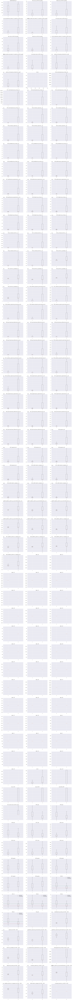

In [23]:
# Строим боксплот без выбросов
N = len(df_2021.columns)//3 + 1

plt.figure(figsize=(30,8*N))

i=1
for col_name in df_2021.columns:    
    plt.subplot(N,3,i)
    try:
        plt.boxplot([df_2021.query('fact_pdz==0')[col_name].dropna(), df_2021.query('fact_pdz==1')[col_name].dropna()], showfliers=False)
    except:
        pass
    
    if '_Z' in col_name:
        plt.axhline(y=1.23, color='r', linestyle='--', label='bankrupt')
        plt.axhline(y=2.9, color='g', linestyle='--', label='uncertainty')
        plt.legend()
        
    plt.title(col_name)
    i+=1

### Подготовка данных для кластеризации

In [24]:
cols_to_fillna_0 = []
for col_name in df_2021.columns:
    if 'факт' in col_name:
        cols_to_fillna_0.append(col_name)
        
df_2021[cols_to_fillna_0] = df_2021[cols_to_fillna_0].fillna(0)

### Кластеризация

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 2 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1
 1 1 0 1 1 1 1 1 1 1 0 1 1 1 2 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 0
 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1
 1 1 1 0 1 1 1 1 1 2 1 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1
 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0]
   макс_пдз_за_2019_год_дней  кол_во_просрочек_свыше_5_ти_дней_за_2019_год_шт  \
I                                                                               
0                   0.207741                                         0.073909   
1                   0.013716                                         0.022173   
2               

Recommended clusters num =  2


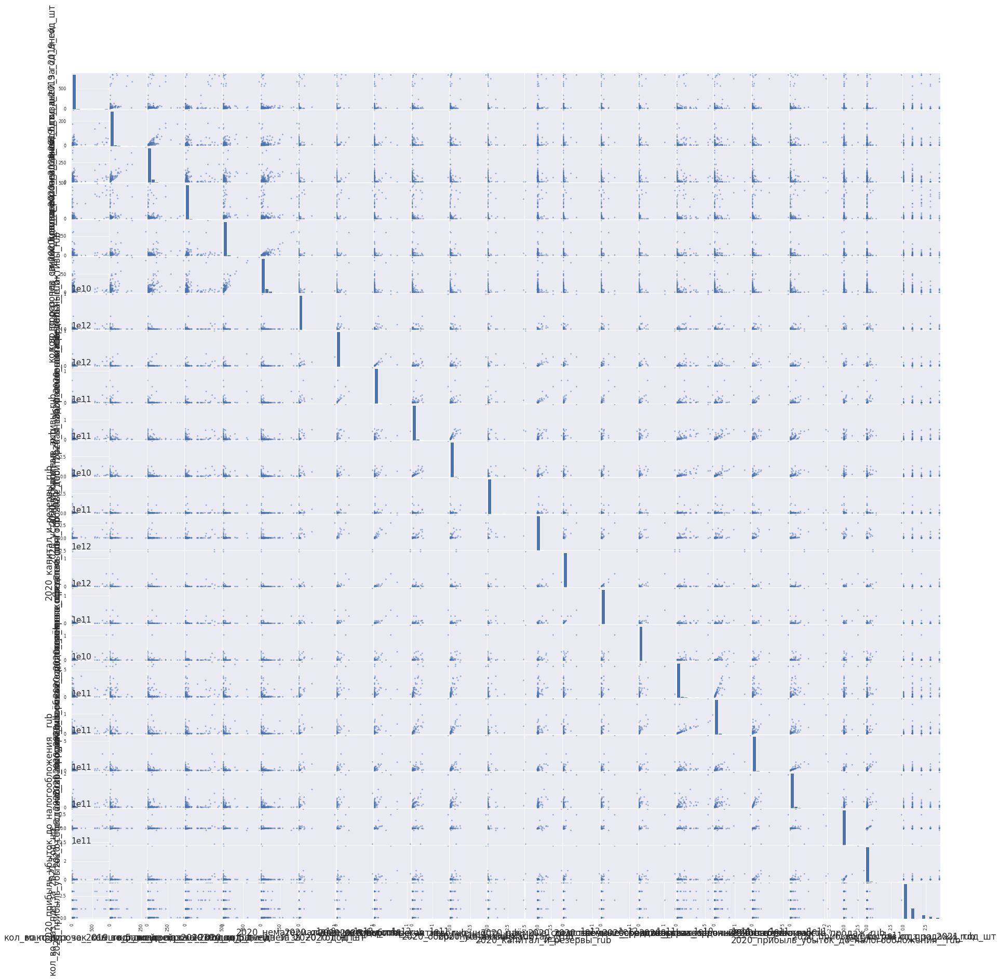

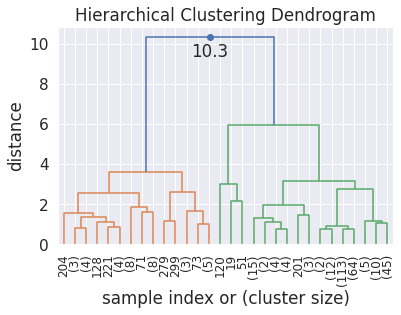

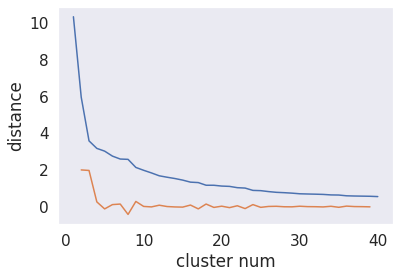

In [25]:
# параметры для деления на кластеры
cols = ['макс_пдз_за_2019_год_дней', 'кол_во_просрочек_свыше_5_ти_дней_за_2019_год_шт',
        'кол_во_раз_пдз_за_2019_год_шт', 'макс_пдз_за_2020_год_дней', 'кол_во_просрочек_свыше_5_ти_дней_за_2020_год_шт', 'кол_во_раз_пдз_за_2020_год_шт',
        '2020_нематериальные_активы_rub', '2020_основные_средства__rub',
        '2020_внеоборотные_активы_rub', '2020_дебиторская_задолженность_rub', '2020_оборотные_активы_rub', '2020_уставный_капитал__rub',
        '2020_капитал_и_резервы_rub', '2020_заёмные_средства_долгосрочные_rub', '2020_долгосрочные_обязательства_rub', '2020_заёмные_средства_краткосрочные_rub',
        '2020_кредиторская_задолженность_rub', '2020_краткосрочные_обязательства_rub', '2020_выручка_rub', '2020_себестоимость_продаж_rub',
        '2020_прибыль_убыток_до_налогообложения__rub', '2020_прибыль_убыток_от_продажи_rub',
        'кол_во_раз_пдз_за_2021_год_шт']

n_clust = 3

# диаграмма рассеивания и гистограммы
scatter_matrix(df_2021[cols], alpha=0.5, figsize=(30, 30))
corr = df_2021[cols].corr()

# нормирование данных перед кластеризацией
from sklearn import preprocessing
dataNorm = preprocessing.MinMaxScaler().fit_transform(df_2021[cols].values)
dfNorm = df_2021[cols].copy()
for idx in range(len(dfNorm.index)):
    dfNorm.iloc[idx,:] = dataNorm[idx]

# кластеризация
clusters = AgglClustering(dfNorm, n_clust, plt_dendrogram = True)

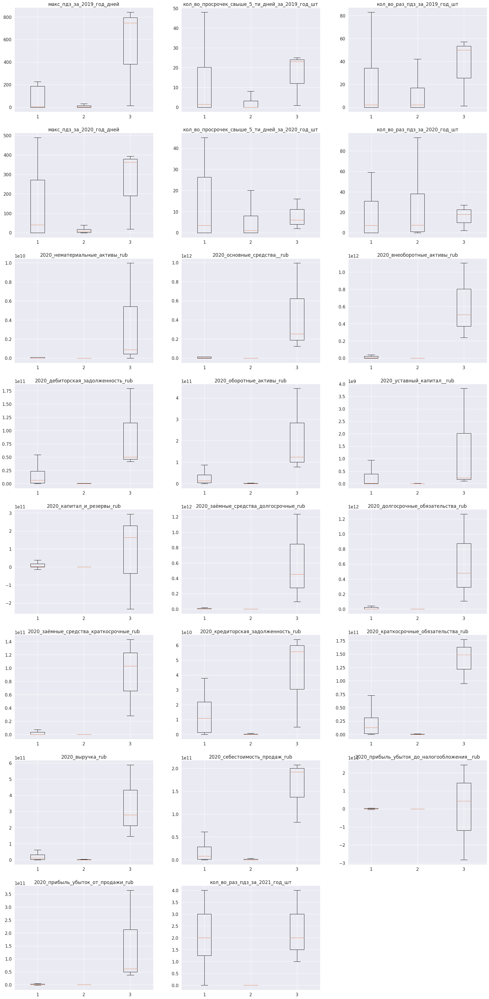

In [26]:
# Строим боксплот без выбросов 
N = len(cols)//3 + 1

plt.figure(figsize=(30,8*N))
df_2021['I'] = dfNorm['I'].copy()

i=1
for col_name in cols:    
    plt.subplot(N,3,i)
    plt.boxplot([df_2021.query('I==0')[col_name], df_2021.query('I==1')[col_name], df_2021.query('I==2')[col_name]], showfliers=False)
    plt.title(col_name)
    i+=1

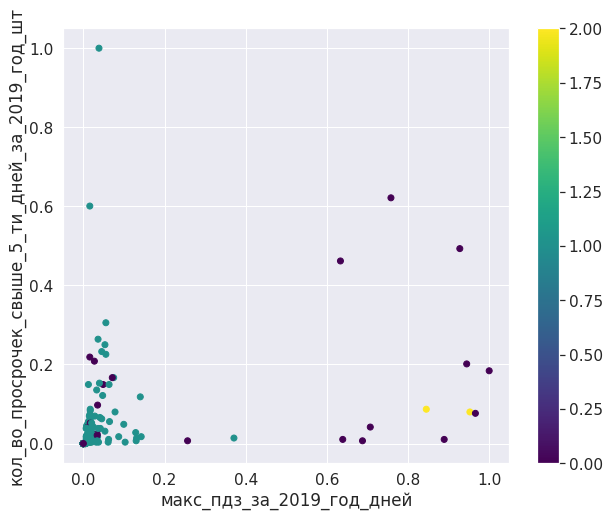

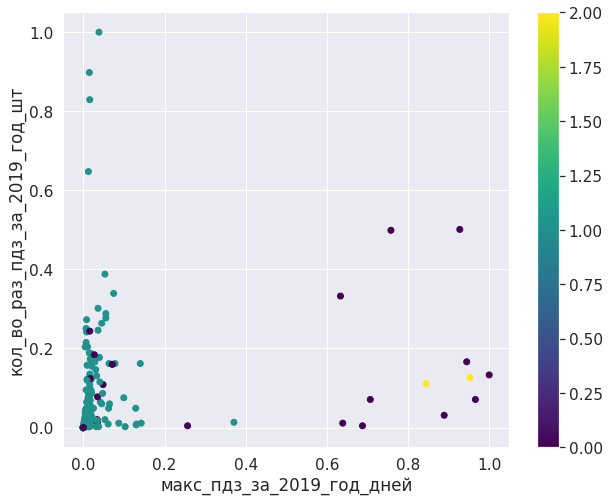

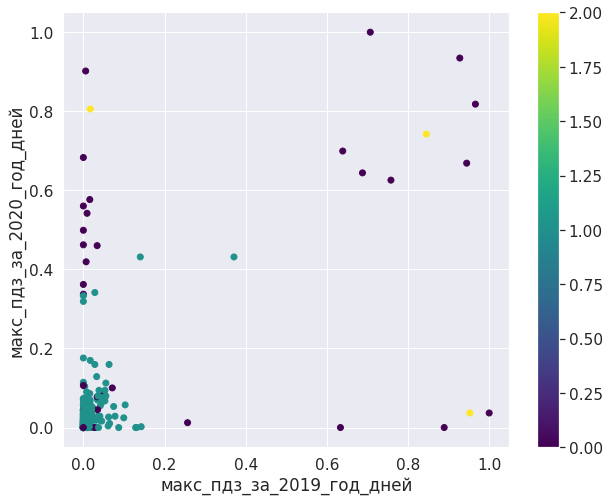

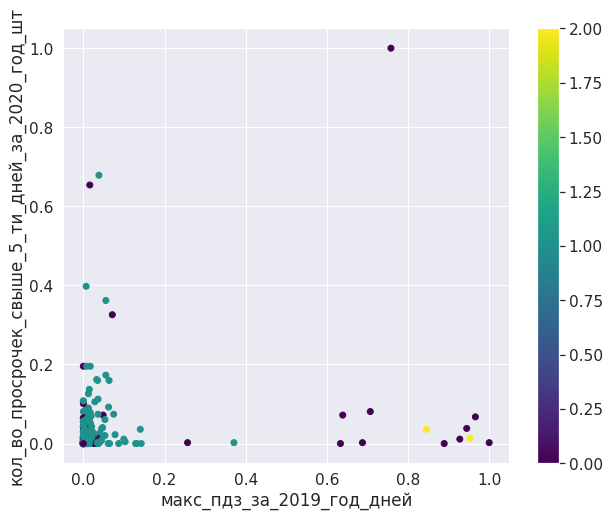

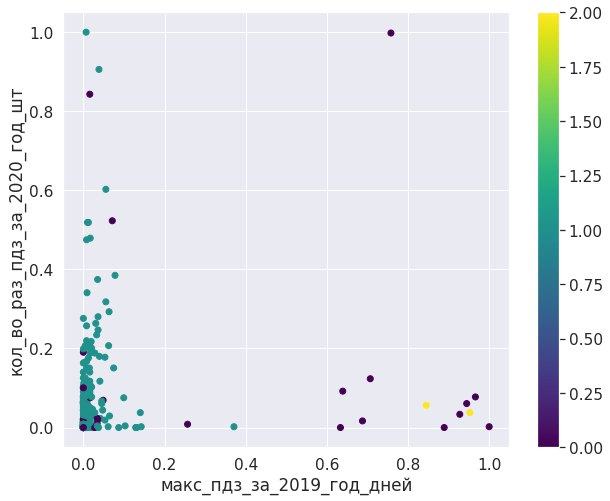

...

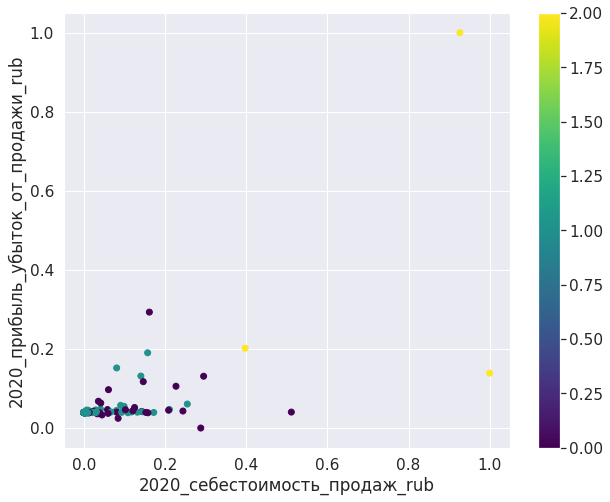

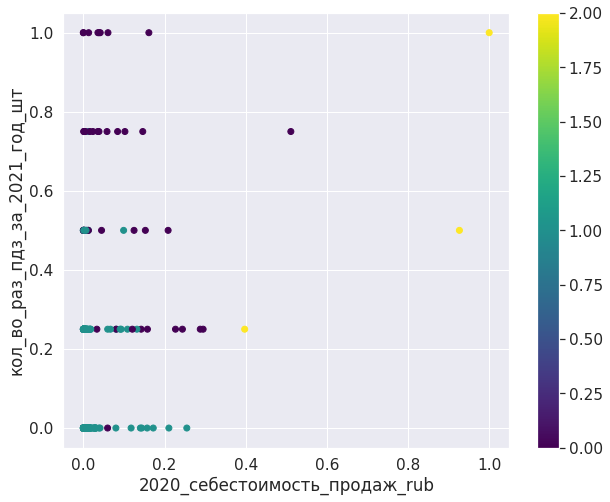

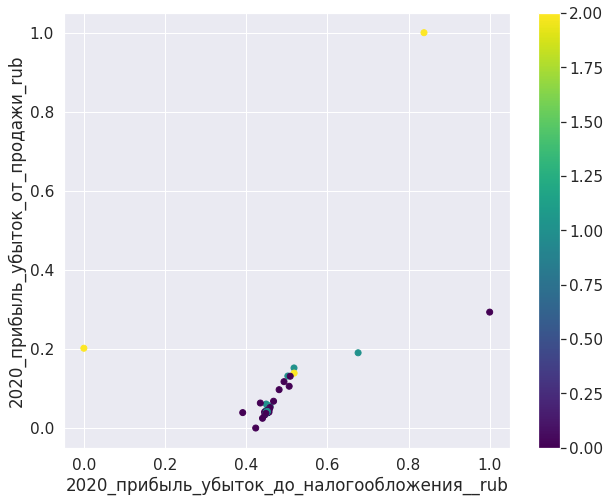

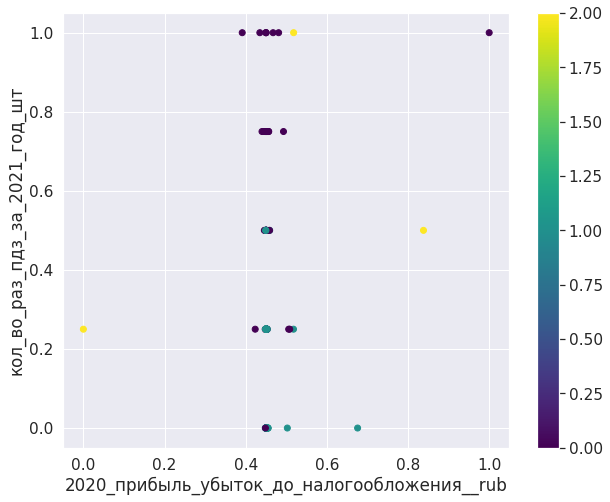

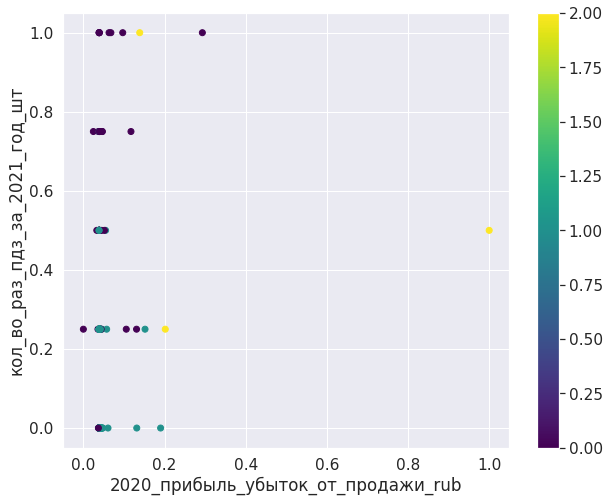

In [27]:
# ДИАГРАММЫ РАССЕИВАНИЯ ПО КЛАСТЕРАМ
for i in range(len(cols)-1):
    for j in range(i+1, len(cols)):
        plt.figure(figsize=(10, 8))
        plt.scatter(dataNorm[:,i], dataNorm[:,j], c=clusters.labels_, cmap='viridis')
        plt.colorbar()
        plt.xlabel(cols[i])
        plt.ylabel(cols[j])

In [28]:
df_2021 = df_2021.drop(columns=['I'])

### Матрица корреляций

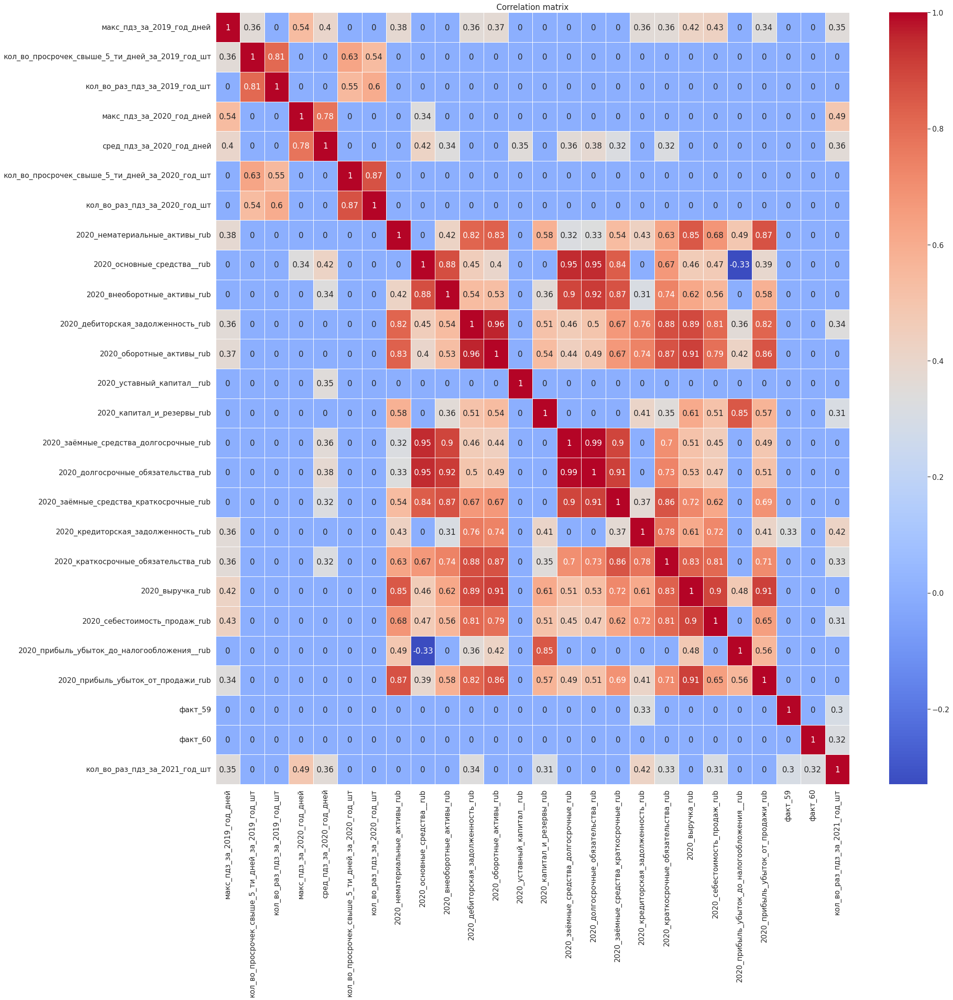

In [29]:
cols = ['макс_пдз_за_2019_год_дней', 'кол_во_просрочек_свыше_5_ти_дней_за_2019_год_шт',
        'кол_во_раз_пдз_за_2019_год_шт', 'макс_пдз_за_2020_год_дней', 'сред_пдз_за_2020_год_дней', 'кол_во_просрочек_свыше_5_ти_дней_за_2020_год_шт', 
        'кол_во_раз_пдз_за_2020_год_шт', '2020_нематериальные_активы_rub', '2020_основные_средства__rub',
        '2020_внеоборотные_активы_rub', '2020_дебиторская_задолженность_rub', '2020_оборотные_активы_rub', '2020_уставный_капитал__rub',
        '2020_капитал_и_резервы_rub', '2020_заёмные_средства_долгосрочные_rub', '2020_долгосрочные_обязательства_rub', '2020_заёмные_средства_краткосрочные_rub',
        '2020_кредиторская_задолженность_rub', '2020_краткосрочные_обязательства_rub', '2020_выручка_rub', '2020_себестоимость_продаж_rub',
        '2020_прибыль_убыток_до_налогообложения__rub', '2020_прибыль_убыток_от_продажи_rub', 'факт_59', 'факт_60',
        'кол_во_раз_пдз_за_2021_год_шт']

plt.figure(figsize=(30, 30))

corr_matrix = df_2021[cols].corr()
corr_matrix = np.round(corr_matrix, 2)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix')
plt.show()

## Анализ данных за 2019 и 2020 годы

In [30]:
df = pd.read_csv('df_by_years_total.csv').query('YY != 2021')

In [31]:
df = df.drop(columns='YY')
for col_name in df.columns:
    if 'итого' in col_name:
        df = df.drop(columns=[col_name])
df

,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,YY_2_Z,YY_2_внеоборотные_активы_rub,YY_2_выручка_rub,YY_2_ддзоа,YY_2_дебиторская_задолженность_rub,YY_2_долгосрочные_обязательства_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_2_капитал_и_резервы_rub,YY_2_краткосрочные_обязательства_rub,YY_2_кредиторская_задолженность_rub,YY_2_нематериальные_активы_rub,YY_2_оборотные_активы_rub,YY_2_одз,YY_2_основные_средства__rub,YY_2_пгдз,YY_2_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_от_продажи_rub,YY_2_себестоимость_продаж_rub,YY_2_уставный_капитал__rub,YY_3_Z,YY_3_внеоборотные_активы_rub,YY_3_выручка_rub,YY_3_ддзоа,YY_3_дебиторская_задолженность_rub,YY_3_долгосрочные_обязательства_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_3_капитал_и_резервы_rub,YY_3_краткосрочные_обязательства_rub,YY_3_кредиторская_задолженность_rub,YY_3_нематериальные_активы_rub,YY_3_оборотные_активы_rub,YY_3_одз,YY_3_основные_средства__rub,YY_3_пгдз,YY_3_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_от_продажи_rub,YY_3_себестоимость_продаж_rub,YY_3_уставный_капитал__rub,YY_4_Z,YY_4_внеоборотные_активы_rub,YY_4_выручка_rub,YY_4_ддзоа,YY_4_дебиторская_задолженность_rub,YY_4_долгосрочные_обязательства_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_4_капитал_и_резервы_rub,YY_4_краткосрочные_обязательства_rub,YY_4_кредиторская_задолженность_rub,YY_4_нематериальные_активы_rub,YY_4_оборотные_активы_rub,YY_4_одз,YY_4_основные_средства__rub,YY_4_пгдз,YY_4_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_от_продажи_rub,YY_4_себестоимость_продаж_rub,YY_4_уставный_капитал__rub,YY_5_Z,YY_5_внеоборотные_активы_rub,YY_5_выручка_rub,YY_5_ддзоа,YY_5_дебиторская_задолженность_rub,YY_5_долгосрочные_обязательства_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_5_капитал_и_резервы_rub,YY_5_краткосрочные_обязательства_rub,YY_5_кредиторская_задолженность_rub,YY_5_нематериальные_активы_rub,YY_5_оборотные_активы_rub,YY_5_основные_средства__rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_5_себестоимость_продаж_rub,YY_5_уставный_капитал__rub,Z,внеоборотные_активы_rub,выручка_rub,ддзоа,дебиторская_задолженность_rub,долгосрочные_обязательства_rub,заёмные_средства_долгосрочные_rub,заёмные_средства_краткосрочные_rub,капитал_и_резервы_rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_2_год_шт,кол_во_раз_пдз_за_год_шт,краткосрочные_обязательства_rub,кредиторская_задолженность_rub,макс_пдз_за_YY_1_год_дней,макс_пдз_за_YY_2_год_дней,макс_пдз_за_год_дней,наименование_дп,нематериальные_активы_rub,оборотные_активы_rub,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_YY_2_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,одз,основные_средства__rub,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,пгдз,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,прибыль_убыток_до_налогообложения__rub,прибыль_убыток_от_продажи_rub,себестоимость_продаж_rub,сред_пдз_за_YY_1_год_дней,сред_пдз_за_YY_2_год_дней,сред_пдз_за_год_дней,уставный_капитал__rub
531,2.886633,3.737611e+09,3.234755e+10,0.741127,3.692142e+09,2.764834e+08,0.000000e+00,0.000000e+00,4.865035e+09,3.577885e+09,3.478978e+09,9.885987e+06,4

In [32]:
cols = ['кол_во_просрочек_свыше_5_ти_дней_за_год_шт',
 'кол_во_раз_пдз_за_год_шт',
 'макс_пдз_за_год_дней',
 'общая_сумма_пдз_свыше_5_ти_дней_за_год_руб',
 'сред_пдз_за_год_дней']

for col_name in df.columns:
    if 'YY_1' in col_name:
        cols.append(col_name)
cols

['кол_во_просрочек_свыше_5_ти_дней_за_год_шт',
 'кол_во_раз_пдз_за_год_шт',
 'макс_пдз_за_год_дней',
 'общая_сумма_пдз_свыше_5_ти_дней_за_год_руб',
 'сред_пдз_за_год_дней',
 'YY_1_Z',
 'YY_1_внеоборотные_активы_rub',
 'YY_1_выручка_rub',
 'YY_1_ддзоа',
 'YY_1_дебиторская_задолженность_rub',
 'YY_1_долгосрочные_обязательства_rub',
 'YY_1_заёмные_средства_долгосрочные_rub',
 'YY_1_заёмные_средства_краткосрочные_rub',
 'YY_1_капитал_и_резервы_rub',
 'YY_1_краткосрочные_обязательства_rub',
 'YY_1_кредиторская_задолженность_rub',
 'YY_1_нематериальные_активы_rub',
 'YY_1_оборотные_активы_rub',
 'YY_1_одз',
 'YY_1_основные_средства__rub',
 'YY_1_пгдз',
 'YY_1_прибыль_убыток_до_налогообложения__rub',
 'YY_1_прибыль_убыток_от_продажи_rub',
 'YY_1_себестоимость_продаж_rub',
 'YY_1_уставный_капитал__rub',
 'кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт',
 'кол_во_раз_пдз_за_YY_1_год_шт',
 'макс_пдз_за_YY_1_год_дней',
 'общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб',
 'сред_пдз_за_YY_1_год_дн

                                                 кол_во_просрочек_свыше_5_ти_дней_за_год_шт  \
кол_во_просрочек_свыше_5_ти_дней_за_год_шт                                         1.000000   
кол_во_раз_пдз_за_год_шт                                                           0.842067   
макс_пдз_за_год_дней                                                               0.313220   
общая_сумма_пдз_свыше_5_ти_дней_за_год_руб                                         0.697571   
сред_пдз_за_год_дней                                                               0.160235   
YY_1_Z                                                                            -0.005572   
YY_1_внеоборотные_активы_rub                                                       0.016726   
YY_1_выручка_rub                                                                   0.036281   
YY_1_ддзоа                                                                         0.018571   
YY_1_дебиторская_задолженность_rub                

Recommended clusters num =  2


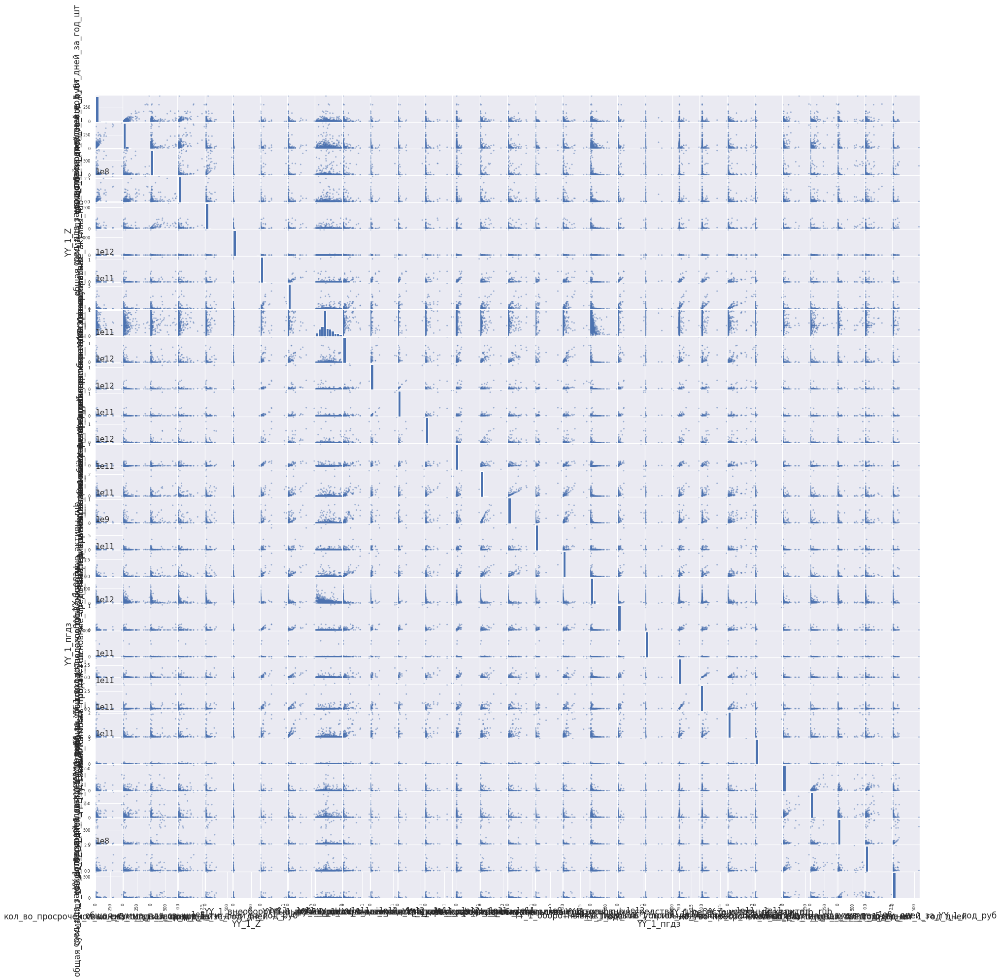

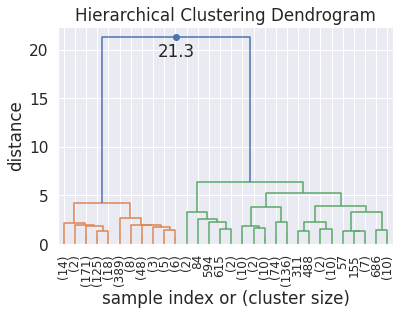

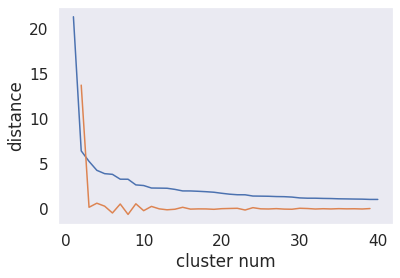

In [33]:
# параметры для различного деления на кластеры
n_clust = 2

# диаграмма рассеивания и гистограммы
scatter_matrix(df[cols], alpha=0.5, figsize=(30, 30))
corr = df[cols].corr()
print(df[cols].corr())

# нормирование данных перед кластеризацией
from sklearn import preprocessing
dataNorm = preprocessing.MinMaxScaler().fit_transform(df[cols].values)
dfNorm = df[cols].copy()
for idx in range(len(dfNorm.index)):
    dfNorm.iloc[idx,:] = dataNorm[idx]

# кластеризация
clusters = AgglClustering(dfNorm, n_clust, plt_dendrogram = True)

In [34]:
df['I'] = dfNorm['I'].copy()
df.query('I==0').describe()

,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,YY_2_Z,YY_2_внеоборотные_активы_rub,YY_2_выручка_rub,YY_2_ддзоа,YY_2_дебиторская_задолженность_rub,YY_2_долгосрочные_обязательства_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_2_капитал_и_резервы_rub,YY_2_краткосрочные_обязательства_rub,YY_2_кредиторская_задолженность_rub,YY_2_нематериальные_активы_rub,YY_2_оборотные_активы_rub,YY_2_одз,YY_2_основные_средства__rub,YY_2_пгдз,YY_2_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_от_продажи_rub,YY_2_себестоимость_продаж_rub,YY_2_уставный_капитал__rub,YY_3_Z,YY_3_внеоборотные_активы_rub,YY_3_выручка_rub,YY_3_ддзоа,YY_3_дебиторская_задолженность_rub,YY_3_долгосрочные_обязательства_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_3_капитал_и_резервы_rub,YY_3_краткосрочные_обязательства_rub,YY_3_кредиторская_задолженность_rub,YY_3_нематериальные_активы_rub,YY_3_оборотные_активы_rub,YY_3_одз,YY_3_основные_средства__rub,YY_3_пгдз,YY_3_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_от_продажи_rub,YY_3_себестоимость_продаж_rub,YY_3_уставный_капитал__rub,YY_4_Z,YY_4_внеоборотные_активы_rub,YY_4_выручка_rub,YY_4_ддзоа,YY_4_дебиторская_задолженность_rub,YY_4_долгосрочные_обязательства_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_4_капитал_и_резервы_rub,YY_4_краткосрочные_обязательства_rub,YY_4_кредиторская_задолженность_rub,YY_4_нематериальные_активы_rub,YY_4_оборотные_активы_rub,YY_4_одз,YY_4_основные_средства__rub,YY_4_пгдз,YY_4_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_от_продажи_rub,YY_4_себестоимость_продаж_rub,YY_4_уставный_капитал__rub,YY_5_Z,YY_5_внеоборотные_активы_rub,YY_5_выручка_rub,YY_5_ддзоа,YY_5_дебиторская_задолженность_rub,YY_5_долгосрочные_обязательства_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_5_капитал_и_резервы_rub,YY_5_краткосрочные_обязательства_rub,YY_5_кредиторская_задолженность_rub,YY_5_нематериальные_активы_rub,YY_5_оборотные_активы_rub,YY_5_основные_средства__rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_5_себестоимость_продаж_rub,YY_5_уставный_капитал__rub,Z,внеоборотные_активы_rub,выручка_rub,ддзоа,дебиторская_задолженность_rub,долгосрочные_обязательства_rub,заёмные_средства_долгосрочные_rub,заёмные_средства_краткосрочные_rub,капитал_и_резервы_rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_2_год_шт,кол_во_раз_пдз_за_год_шт,краткосрочные_обязательства_rub,кредиторская_задолженность_rub,макс_пдз_за_YY_1_год_дней,макс_пдз_за_YY_2_год_дней,макс_пдз_за_год_дней,наименование_дп,нематериальные_активы_rub,оборотные_активы_rub,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_YY_2_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,одз,основные_средства__rub,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,пгдз,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,прибыль_убыток_до_налогообложения__rub,прибыль_убыток_от_продажи_rub,себестоимость_продаж_rub,сред_пдз_за_YY_1_год_дней,сред_пдз_за_YY_2_год_дней,сред_пдз_за_год_дней,уставный_капитал__rub,I
count,273.000000,2.730000e+02,2.730000e+02,273.000000,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.7300

In [35]:
df[cols+['I']].groupby('I').mean()

,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_год_шт,макс_пдз_за_год_дней,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,сред_пдз_за_год_дней,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,макс_пдз_за_YY_1_год_дней,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,сред_пдз_за_YY_1_год_дней
I,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,15.124542,33.871795,66.351648,1.084628e+07,16.087461,48.354090,2.637953e+10,1.774952e+10,0.654291,6.136807e+09,1.871684e+10,1.458542e+10,2.884437e+09,1.231456e+10,8.256060e+09,4.946448e+09,1.306697e+08,1.290793e+10,7.222512,2.041683e+10,138.937117,5.008357e+09,5.621070e+09,1.093126e+10,2.368193e+09,5.311355,13.003663,41.593407,4.467143e+06,9.305163
1,4.363752,13.948035,10.455006,3.152451e+06,4.408743,372.878062,2.459014e+09,2.932702e+09,0.345894,6.219410e+08,1.274805e+09,9.165821e+08,2.650518e+08,1.898642e+09,1.105483e+09,7.938544e+08,1.241232e+07,1.835276e+09,12.351692,1.101015e+09,322.555630,5.480642e+08,6.012402e+08,2.076852e+09,1.898272e+08,2.531052,9.600760,7.645120,1.702053e+06,3.551393


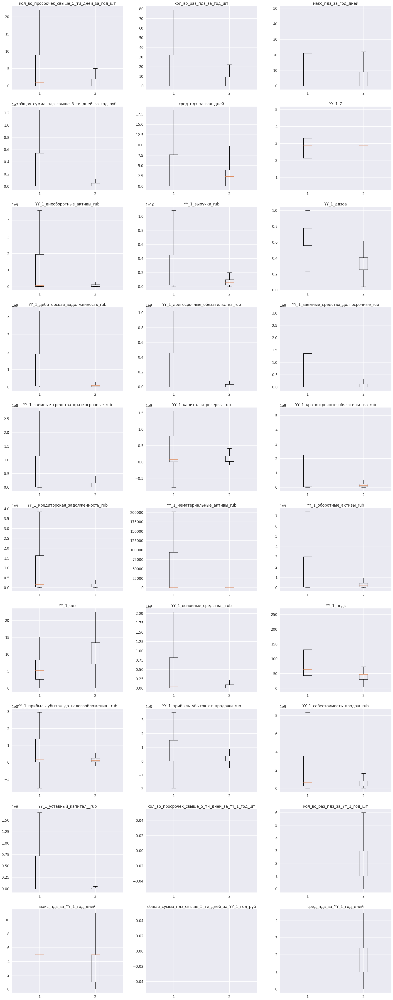

In [36]:
# Строим боксплот без выбросов
N = len(cols)//3 + 1

plt.figure(figsize=(30,8*N))

i=1
for col_name in cols:    
    plt.subplot(N,3,i)
    plt.boxplot([df.query('I==0')[col_name], df.query('I==1')[col_name]], showfliers=False)
    plt.title(col_name)
    i+=1

In [37]:
dfNorm

,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_год_шт,макс_пдз_за_год_дней,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,сред_пдз_за_год_дней,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,макс_пдз_за_YY_1_год_дней,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,сред_пдз_за_YY_1_год_дней,I
531,0.008989,0.010460,0.011312,0.018967,0.010526,0.007110,3.286946e-03,0.057833,0.737959,0.027099,0.000237,1.839381e-08,0.000003,0.146357,0.015385,0.032033,0.001121,0.013274,0.051988,3.429679e-03,0.000407,0.255185,0.078594,0.126638,1.245908e-03,0.000000,0.000000,0.000000,0.011883,0.000000,0
532,0.000000,0.002092,0.005656,0.010848,0.003921,0.007110,3.842467e-05,0.001037,0.395966,0.000587,0.000008,1.839381e-08,0.000026,0.142338,0.000553,0.000889,0.000000,0.000579,0.044033,3.011399e-05,0.000482,0.248402,0.068676,0.002352,1.260839e-07,0.000000,0.000000,0.000000,0.011883,0.000000,1
533,0.004494,0.006276,0.006787,0.024537,0.008772,0.007110,1.084693e-03,0.004924,0.319926,0.002033,0.000001,1.839381e-08,0.000003,0.143836,0.000931,0.001061,0.000562,0.002232,0.062816,9.772384e-04,0.000337,0.247166,0.068304,0.011656,3.888680e-05,0.003472,0.004435,0.007919,0.012412,0.009046,1
534,0.000000,0.002092,0.005656,0.010848,0.003921,0.007110,3.842467e-05,0.001037,0.395966,0.000587,0.000008,1.839381e-08,0.000026,0.142338,0.000553,0.000889,0.000000,0.000579,0.044033,3.011399e-05,0.000482,0.248402,0.068676,0.002352,1.260839e-07,0.000000,0.000000,0.000000,0.011883,0.000000,1
535,0.000000,0.004184,0.001131,0.010848,0.001645,0.007119,1.061131e-01,0.168234,0.685783,0.077222,0.083783,8.357588e-02,0.185448,0.147648,0.134686,0.044206,0.000045,0.040633,0.049796,2.878396e-02,0.000425,0.341987,0.221702,0.144749,1.178885e-06,0.000000,0.004435,0.002262,0.011883,0.003289,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1588,0.000000,0.000000,0.000000,0.010848,0.000000,0.007110,7.393884e-07,0.000206,0.284016,0.000188,0.000028,2.797699e-05,0.000003,0.142288,0.000214,0.000457,0.000000,0.000231,0.027669,7.996312e-07,0.001907,0.248396,0.068652,0.000496,1.260839e-08,0.000000,0.006652,0.005656,0.011883,0.003921,1
1589,0.000000,0.000000,0.000000,0.010848,0.000000,0.007110,1.277310e-04,0.002124,0.205056,0.000608,0.000003,1.839381e-08,0.000003,0.142590,0.000672,0.001263,0.000002,0.001012,0.044637,1.248206e-04,0.000452,0.248536,0.068810,0.004776,4.763577e-04,0.000000,0.006652,0.005656,0.011883,0.003921,1
1590,0.000000,0.000000,0.000000,0.010848,0.000000,0.007092,0.000000e+00,0.000000,0.395966,0.000000,0.000001,1.839381e-08,0.000003,0.142283,0.000000,0.000000,0.000000,0.000000,0.044033,0.000000e+00,0.000482,0.248385,0.068633,0.000000,0.000000e+00,0.000000,0.006652,0.005656,0.011883,0.003921,1
1591,0.000000,0.000000,0.000000,0.010848,0.000000,0.007110,4.329360e-04,0.000765,0.168560,0.000583,0.000164,1.458423e-04,0.000282,0.142426,0.002443,0.004874,0.000000,0.001163,0.019962,2.962331e-05,0.002421,0.248709,0.069192,0.000616,1.386923e-08,0.000000,0.006652,0.005656,0.011883,0.003921,1


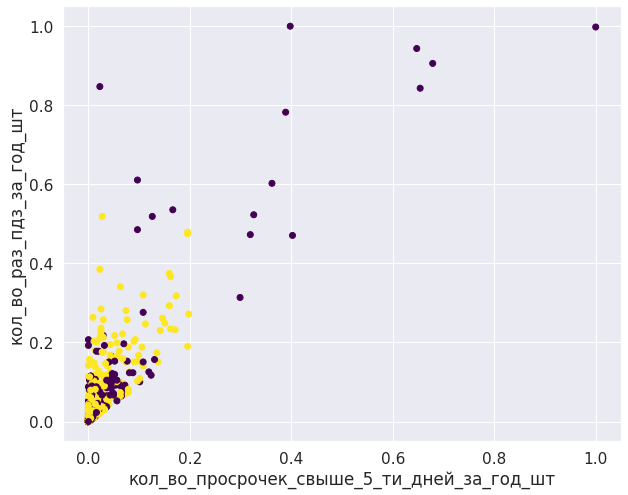

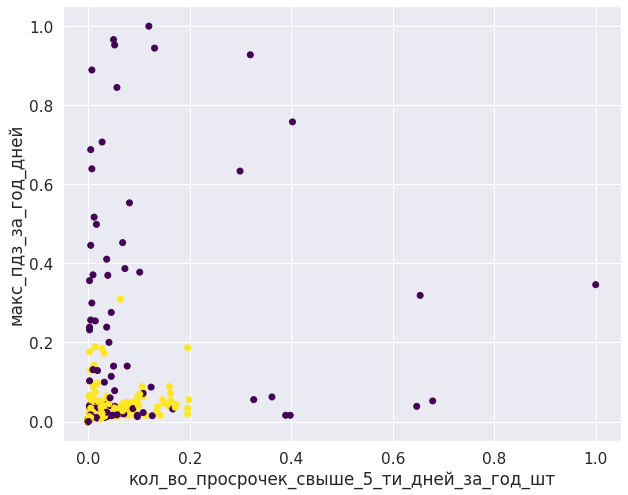

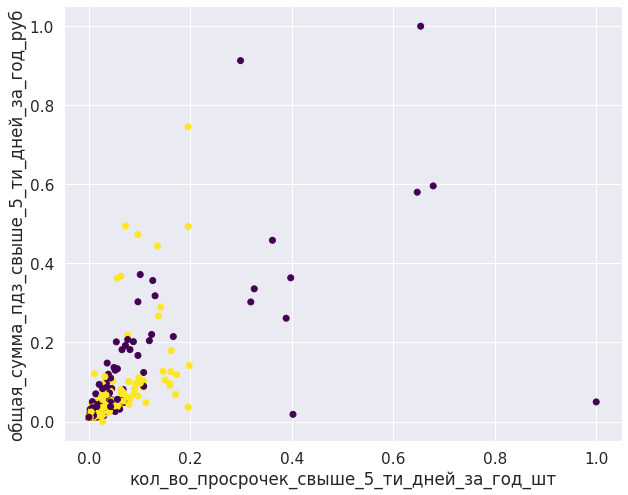

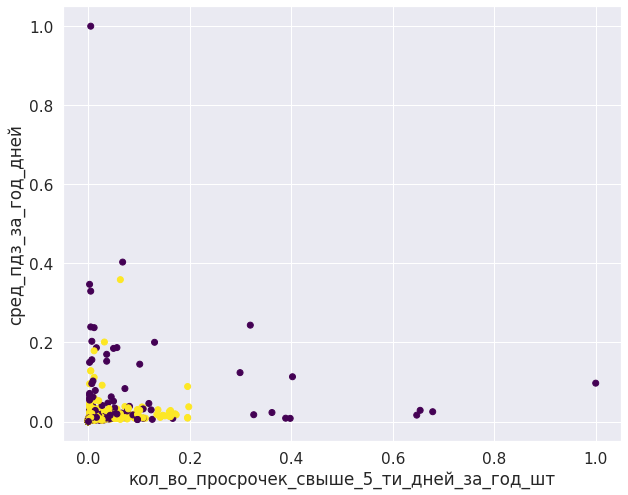

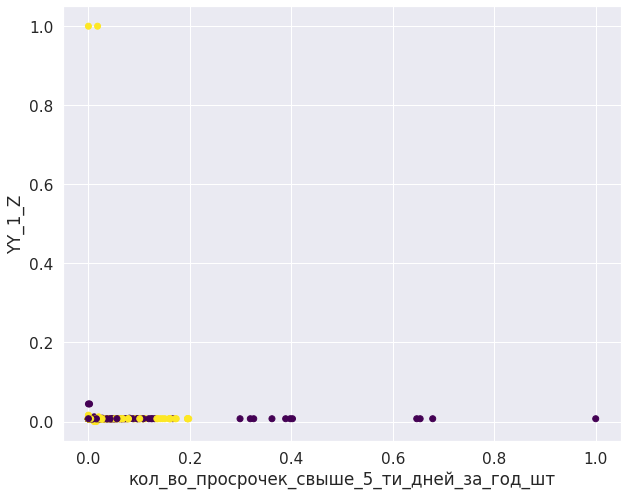

...

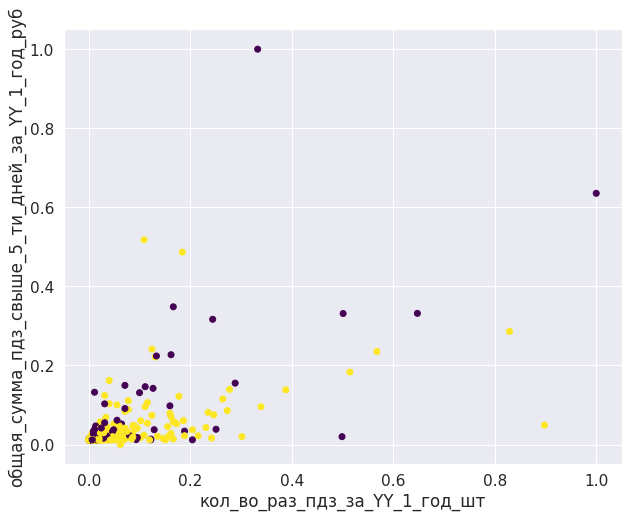

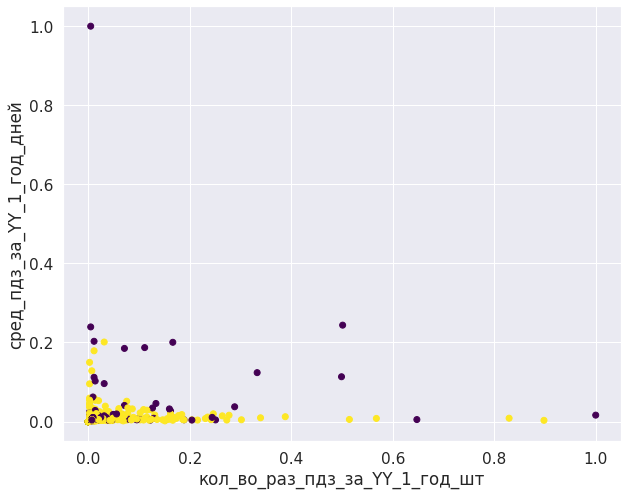

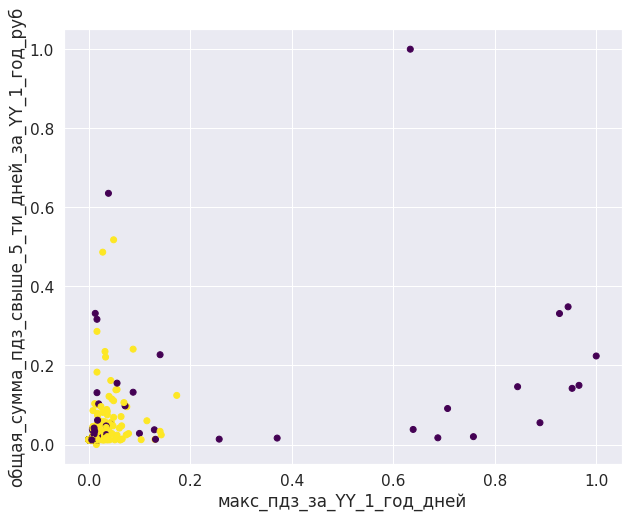

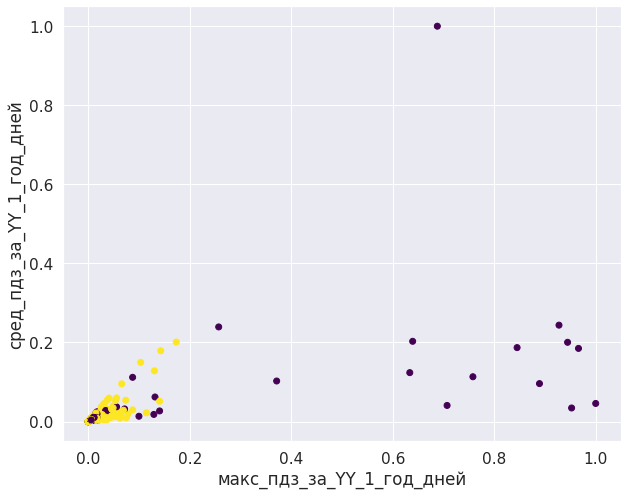

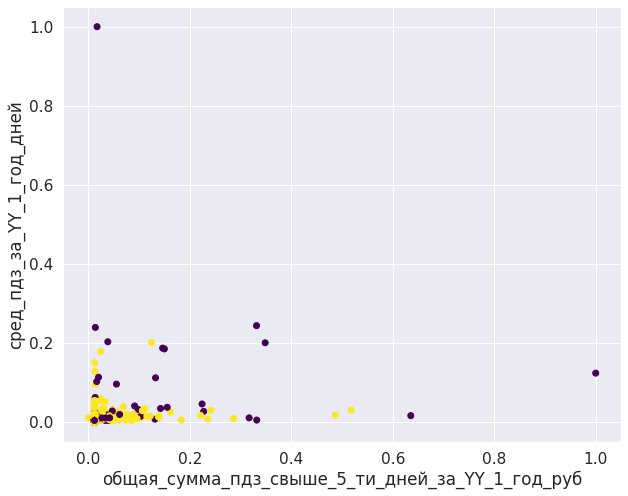

In [38]:
# ДИАГРАММЫ РАССЕИВАНИЯ ПО КЛАСТЕРАМ
for i in range(len(cols)-1):
    for j in range(i+1, len(cols)):
        plt.figure(figsize=(10, 8))
        plt.scatter(dataNorm[:,i], dataNorm[:,j], c=clusters.labels_, cmap='viridis')
        plt.xlabel(cols[i])
        plt.ylabel(cols[j])

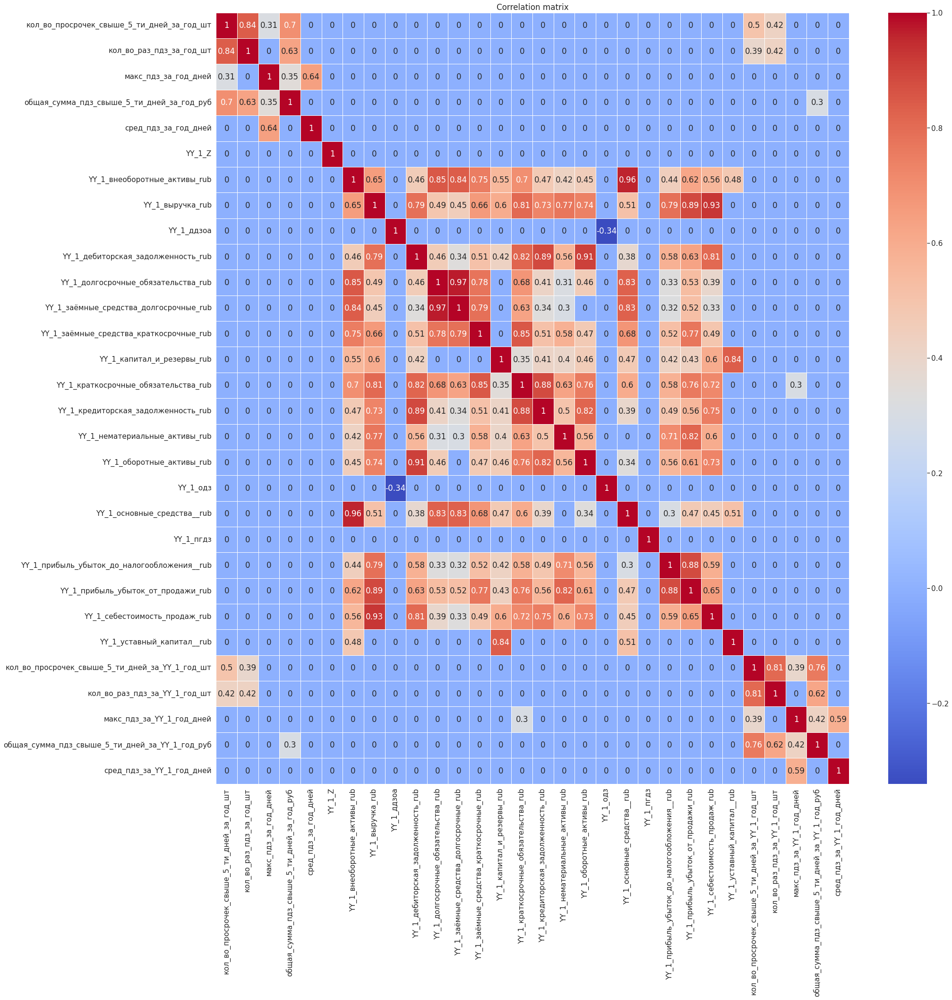

In [39]:
plt.figure(figsize=(30, 30))

corr_matrix = df[cols].corr()
corr_matrix = np.round(corr_matrix, 2)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix')
plt.show()

## Анализ всех данных

In [40]:
df = pd.read_csv('df_by_years_total.csv')

In [41]:
list(df.columns)

['YY',
 'YY_1_Z',
 'YY_1_внеоборотные_активы_rub',
 'YY_1_выручка_rub',
 'YY_1_ддзоа',
 'YY_1_дебиторская_задолженность_rub',
 'YY_1_долгосрочные_обязательства_rub',
 'YY_1_заёмные_средства_долгосрочные_rub',
 'YY_1_заёмные_средства_краткосрочные_rub',
 'YY_1_итого',
 'YY_1_капитал_и_резервы_rub',
 'YY_1_краткосрочные_обязательства_rub',
 'YY_1_кредиторская_задолженность_rub',
 'YY_1_нематериальные_активы_rub',
 'YY_1_оборотные_активы_rub',
 'YY_1_одз',
 'YY_1_основные_средства__rub',
 'YY_1_пгдз',
 'YY_1_прибыль_убыток_до_налогообложения__rub',
 'YY_1_прибыль_убыток_от_продажи_rub',
 'YY_1_себестоимость_продаж_rub',
 'YY_1_уставный_капитал__rub',
 'YY_2_Z',
 'YY_2_внеоборотные_активы_rub',
 'YY_2_выручка_rub',
 'YY_2_ддзоа',
 'YY_2_дебиторская_задолженность_rub',
 'YY_2_долгосрочные_обязательства_rub',
 'YY_2_заёмные_средства_долгосрочные_rub',
 'YY_2_заёмные_средства_краткосрочные_rub',
 'YY_2_капитал_и_резервы_rub',
 'YY_2_краткосрочные_обязательства_rub',
 'YY_2_кредиторская_задолж

In [42]:
df['fact_pdz'] = df['кол_во_раз_пдз_за_год_шт'].apply(lambda x: 0 if x == 0 else 1)

In [43]:
change_cols = ['внеоборотные_активы_rub', 'выручка_rub', 'заёмные_средства_долгосрочные_rub', 'заёмные_средства_краткосрочные_rub', 'капитал_и_резервы_rub', \
               'кредиторская_задолженность_rub', 'нематериальные_активы_rub', 'оборотные_активы_rub', 'основные_средства__rub', 'прибыль_убыток_до_налогообложения__rub', \
               'прибыль_убыток_от_продажи_rub', 'себестоимость_продаж_rub', 'уставный_капитал__rub']

for col_name in change_cols:
    for i in range(1,5):
        df['YY_{}_{}_change'.format(i, col_name)] = df['YY_{}_{}'.format(i, col_name)] - df['YY_{}_{}'.format(i+1, col_name)]

In [44]:
df

,YY,YY_1_Z,YY_1_внеоборотные_активы_rub,YY_1_выручка_rub,YY_1_ддзоа,YY_1_дебиторская_задолженность_rub,YY_1_долгосрочные_обязательства_rub,YY_1_заёмные_средства_долгосрочные_rub,YY_1_заёмные_средства_краткосрочные_rub,YY_1_итого,YY_1_капитал_и_резервы_rub,YY_1_краткосрочные_обязательства_rub,YY_1_кредиторская_задолженность_rub,YY_1_нематериальные_активы_rub,YY_1_оборотные_активы_rub,YY_1_одз,YY_1_основные_средства__rub,YY_1_пгдз,YY_1_прибыль_убыток_до_налогообложения__rub,YY_1_прибыль_убыток_от_продажи_rub,YY_1_себестоимость_продаж_rub,YY_1_уставный_капитал__rub,YY_2_Z,YY_2_внеоборотные_активы_rub,YY_2_выручка_rub,YY_2_ддзоа,YY_2_дебиторская_задолженность_rub,YY_2_долгосрочные_обязательства_rub,YY_2_заёмные_средства_долгосрочные_rub,YY_2_заёмные_средства_краткосрочные_rub,YY_2_капитал_и_резервы_rub,YY_2_краткосрочные_обязательства_rub,YY_2_кредиторская_задолженность_rub,YY_2_нематериальные_активы_rub,YY_2_оборотные_активы_rub,YY_2_одз,YY_2_основные_средства__rub,YY_2_пгдз,YY_2_прибыль_убыток_до_налогообложения__rub,YY_2_прибыль_убыток_от_продажи_rub,YY_2_себестоимость_продаж_rub,YY_2_уставный_капитал__rub,YY_3_Z,YY_3_внеоборотные_активы_rub,YY_3_выручка_rub,YY_3_ддзоа,YY_3_дебиторская_задолженность_rub,YY_3_долгосрочные_обязательства_rub,YY_3_заёмные_средства_долгосрочные_rub,YY_3_заёмные_средства_краткосрочные_rub,YY_3_капитал_и_резервы_rub,YY_3_краткосрочные_обязательства_rub,YY_3_кредиторская_задолженность_rub,YY_3_нематериальные_активы_rub,YY_3_оборотные_активы_rub,YY_3_одз,YY_3_основные_средства__rub,YY_3_пгдз,YY_3_прибыль_убыток_до_налогообложения__rub,YY_3_прибыль_убыток_от_продажи_rub,YY_3_себестоимость_продаж_rub,YY_3_уставный_капитал__rub,YY_4_Z,YY_4_внеоборотные_активы_rub,YY_4_выручка_rub,YY_4_ддзоа,YY_4_дебиторская_задолженность_rub,YY_4_долгосрочные_обязательства_rub,YY_4_заёмные_средства_долгосрочные_rub,YY_4_заёмные_средства_краткосрочные_rub,YY_4_капитал_и_резервы_rub,YY_4_краткосрочные_обязательства_rub,YY_4_кредиторская_задолженность_rub,YY_4_нематериальные_активы_rub,YY_4_оборотные_активы_rub,YY_4_одз,YY_4_основные_средства__rub,YY_4_пгдз,YY_4_прибыль_убыток_до_налогообложения__rub,YY_4_прибыль_убыток_от_продажи_rub,YY_4_себестоимость_продаж_rub,YY_4_уставный_капитал__rub,YY_5_Z,YY_5_внеоборотные_активы_rub,YY_5_выручка_rub,YY_5_ддзоа,YY_5_дебиторская_задолженность_rub,YY_5_долгосрочные_обязательства_rub,YY_5_заёмные_средства_долгосрочные_rub,YY_5_заёмные_средства_краткосрочные_rub,YY_5_капитал_и_резервы_rub,YY_5_краткосрочные_обязательства_rub,YY_5_кредиторская_задолженность_rub,YY_5_нематериальные_активы_rub,YY_5_оборотные_активы_rub,YY_5_основные_средства__rub,YY_5_прибыль_убыток_до_налогообложения__rub,YY_5_прибыль_убыток_от_продажи_rub,YY_5_себестоимость_продаж_rub,YY_5_уставный_капитал__rub,Z,внеоборотные_активы_rub,выручка_rub,ддзоа,дебиторская_задолженность_rub,долгосрочные_обязательства_rub,заёмные_средства_долгосрочные_rub,заёмные_средства_краткосрочные_rub,итого,капитал_и_резервы_rub,кол_во_просрочек_свыше_5_ти_дней_за_YY_1_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_YY_2_год_шт,кол_во_просрочек_свыше_5_ти_дней_за_год_шт,кол_во_раз_пдз_за_YY_1_год_шт,кол_во_раз_пдз_за_YY_2_год_шт,кол_во_раз_пдз_за_год_шт,краткосрочные_обязательства_rub,кредиторская_задолженность_rub,макс_пдз_за_YY_1_год_дней,макс_пдз_за_YY_2_год_дней,макс_пдз_за_год_дней,наименование_дп,нематериальные_активы_rub,оборотные_активы_rub,общая_сумма_пдз_свыше_5_ти_дней_за_YY_1_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_YY_2_год_руб,общая_сумма_пдз_свыше_5_ти_дней_за_год_руб,одз,основные_средства__rub,оценка_потенциала_контрагента_1_руб,оценка_потенциала_контрагента_2_руб,пгдз,пдз_1_30,пдз_31_90,пдз_91_365,пдз_более_365,прибыль_убыток_до_налогообложения__rub,прибыль_убыток_от_продажи_rub,себестоимость_продаж_rub,сред_пдз_за_YY_1_год_дней,сред_пдз_за_YY_2_год_дней,сред_пдз_за_год_дней,уставный_капитал__rub,fact_pdz,YY_1_внеоборотные_активы_rub_change,YY_2_внеоборотные_активы_rub_change,YY_3_внеоборотные_активы_rub_change,YY_4_внеоборотны

In [45]:
list(df.columns)

['YY',
 'YY_1_Z',
 'YY_1_внеоборотные_активы_rub',
 'YY_1_выручка_rub',
 'YY_1_ддзоа',
 'YY_1_дебиторская_задолженность_rub',
 'YY_1_долгосрочные_обязательства_rub',
 'YY_1_заёмные_средства_долгосрочные_rub',
 'YY_1_заёмные_средства_краткосрочные_rub',
 'YY_1_итого',
 'YY_1_капитал_и_резервы_rub',
 'YY_1_краткосрочные_обязательства_rub',
 'YY_1_кредиторская_задолженность_rub',
 'YY_1_нематериальные_активы_rub',
 'YY_1_оборотные_активы_rub',
 'YY_1_одз',
 'YY_1_основные_средства__rub',
 'YY_1_пгдз',
 'YY_1_прибыль_убыток_до_налогообложения__rub',
 'YY_1_прибыль_убыток_от_продажи_rub',
 'YY_1_себестоимость_продаж_rub',
 'YY_1_уставный_капитал__rub',
 'YY_2_Z',
 'YY_2_внеоборотные_активы_rub',
 'YY_2_выручка_rub',
 'YY_2_ддзоа',
 'YY_2_дебиторская_задолженность_rub',
 'YY_2_долгосрочные_обязательства_rub',
 'YY_2_заёмные_средства_долгосрочные_rub',
 'YY_2_заёмные_средства_краткосрочные_rub',
 'YY_2_капитал_и_резервы_rub',
 'YY_2_краткосрочные_обязательства_rub',
 'YY_2_кредиторская_задолж

In [46]:
TARGET_NAME = 'fact_pdz'

In [47]:
# Строим боксплот без выбросов
N = len(df.columns)//3 + 1

plt.figure(figsize=(30,8*N))

i=1
for col_name in df.columns:    
    plt.subplot(N,3,i)
    plt.boxplot([df.query('fact_pdz==0')[col_name].dropna(), df.query('fact_pdz==1')[col_name].dropna()], showfliers=False)
    if '_Z' in col_name:
        plt.axhline(y=1.23, color='r', linestyle='--', label='bankrupt')
        plt.axhline(y=2.9, color='g', linestyle='--', label='uncertainty')
        plt.legend()
        print(col_name, len(df.query('fact_pdz==1 & {} > 1 & {} < 5'.format(col_name, col_name))[col_name].dropna()), df.query('fact_pdz==1')[col_name].min(), df.query('fact_pdz==1')[col_name].max())
#         plt.ylim(2.5,3)
    plt.title(col_name)
    i+=1

YY_1_Z 910 -1033.5101580346018 144729.72880328915
YY_2_Z 910 -1033.5101580346018 144729.72880328915
YY_3_Z 910 -1033.5101580346018 144729.72880328915
YY_4_Z 974 -1033.5101580346018 144729.72880328915
YY_5_Z 1042 -1.0298126374279026 212.53120858988584


**Модель Альтмана позволяет выделить потенциально «плохих» контрагентов и может служить критерием для быстрой проверки контрагента.**

**Небольшая компания с большей вероятностью погасит ДЗ в срок.**

**Если у контрагента ранее была небольшая ПДЗ, скорее всего он и дальше будет возвращать ДЗ в срок.**

**Имеет смысл обратить внимание на факторы 59, 60  (2021 г).**

**Чем меньше изменений в финансовых показателях, тем меньше ПДЗ.**